In [1]:
import numpy as np
import copy
import matplotlib.pyplot as plt
import pickle
import torch
from utils import torch_from_numpy

bif_c = 0.1
num_iter_max=200000
alpha=0.5
# vae_lr=1e-5
vae_lr=5e-4
ratio_lr=5e-4
ratio_early=100
env_name = 'CustomPendulum-v0'

In [2]:
import gym
import custom_gym
env = gym.make(env_name)
s_dim = env.reset().flatten().shape[0]
a_dim = env.action_space.sample().flatten().shape[0]
z_dim = 1
print(s_dim, a_dim, z_dim)

from sac import SAC
agent = SAC(env.observation_space.shape[0], env.action_space)
agent.load_checkpoint(ckpt_path="checkpoints/sac_checkpoint_custom_pendulum_")
agent.policy.my_np_compile()

offline_data = pickle.load(open("offline_data.pkl","rb"))
debug_info = pickle.load(open("offline_data_debug_info.pkl","rb"))
debug_info = np.array(debug_info)

2 1 1
Loading models from checkpoints/sac_checkpoint_custom_pendulum_


C:\Users\toru.hishinuma\anaconda3\envs\iwvi\lib\site-packages\gym\core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
C:\Users\toru.hishinuma\anaconda3\envs\iwvi\lib\site-packages\gym\wrappers\step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
C:\Users\toru.hishinuma\anaconda3\envs\iwvi\lib\site-packages\gym\utils\passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
C:\Users\toru.hishinuma\anaconda3\envs\iwvi\lib\site-packages\gy

In [3]:
args_init_dict = {"offline_data": offline_data,
             "s_dim": s_dim,
             "a_dim": a_dim,
             "z_dim": z_dim,
#              "policy":agent.select_action,
             "policy":agent.policy.my_np_select_action,
                  "debug_info":debug_info,
                  "env" : env}
# import vi_base
# vi = vi_base.baseVI(args_init_dict)
import vi_iw
iwvi = vi_iw.iwVI(args_init_dict)

iwvi.load_base()
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()

load vi_base_ckpt


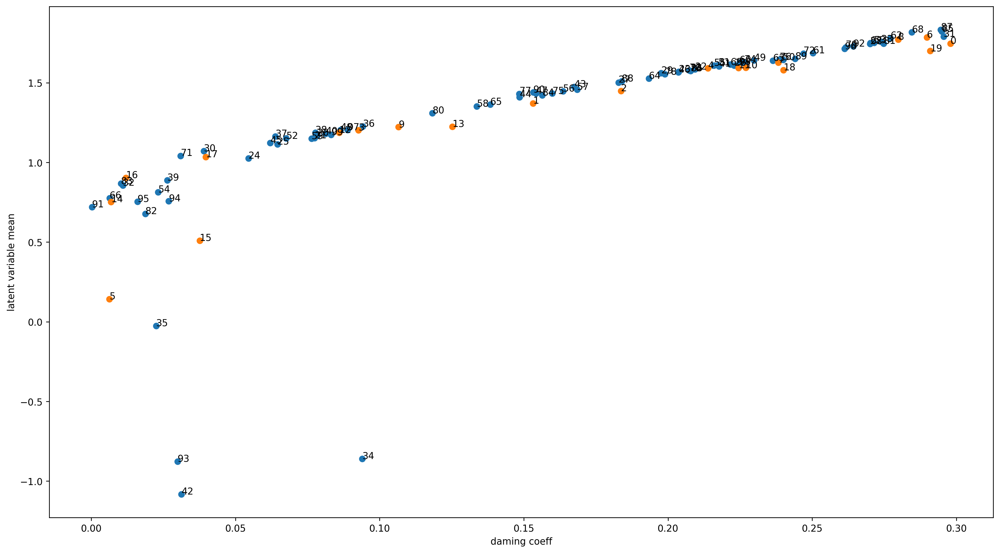

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [4]:
plt.figure(figsize=(18,10), dpi=250)
np_mulogvar = []
for i in range(len(iwvi.mulogvar_list_for_mixture_of_gaussian_belief)):
    np_mulogvar.append(iwvi.mulogvar_list_for_mixture_of_gaussian_belief[i].numpy())
np_mulogvar = np.array(np_mulogvar)
plt.xlabel("daming coeff")
plt.ylabel("latent variable mean")

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([-0.05,0.35])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig("damping_latent.png")
plt.show()

# plt.figure(figsize=(16,12))
# plt.xlim([0.06,0.14])
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [5]:
iwvi.get_real_rollout_data()

0  1  2  3  

C:\Users\toru.hishinuma\anaconda3\envs\iwvi\lib\site-packages\gym\utils\passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the environment with new step API. 
  logger.deprecation(
C:\Users\toru.hishinuma\anaconda3\envs\iwvi\lib\site-packages\gym\utils\passive_env_checker.py:141: UserWarning: WARN: The obs returned by the `step()` method was expecting numpy array dtype to be float32, actual type: float64
  logger.warn(
C:\Users\toru.hishinuma\anaconda3\envs\iwvi\lib\site-packages\gym\utils\passive_env_checker.py:165: UserWarning: WARN: The obs returned by the `step()` method is not within the observation space.
  logger.warn(f"{pre} is not within the observation space.")


4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [6]:
# fig = plt.figure(figsize=(18,10))
# ax_list = []
# for i in range(50):
#     ax_list.append(fig.add_subplot(5, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1]) 
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1]) 
# print("オフラインデータvs実環境方策rollout")

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

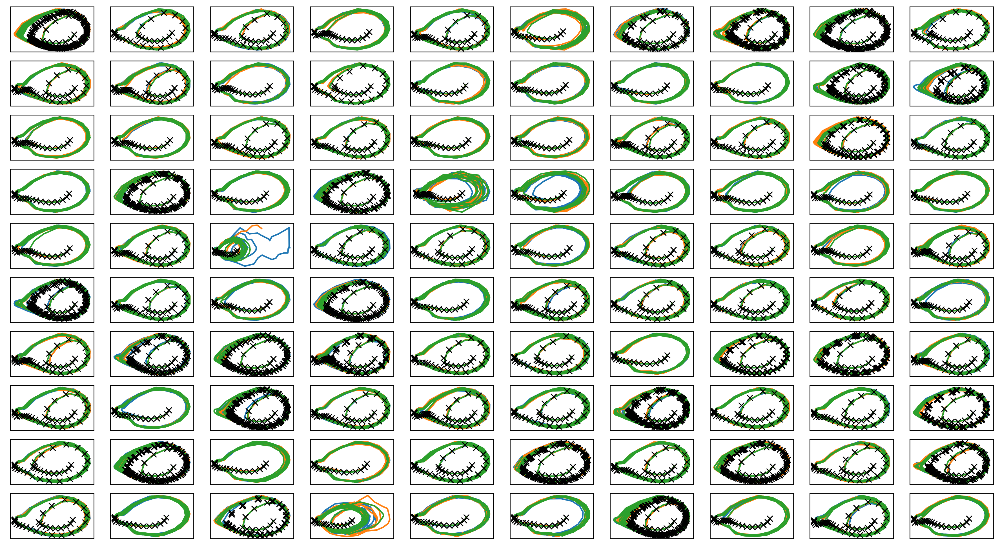

In [7]:
iwvi.get_sim_rollout_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter0.png")
print("実環境方策rollout vs Sim環境方策rollout")

# Iter 1

In [8]:
iwvi.get_sim_rollout_data_randomlen()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [9]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 1.31342  validloss 1.41748±0.00000  bestvalidloss 1.41748  last_update 0
train: iter 1  trainloss 0.98414  validloss 1.16666±0.00000  bestvalidloss 1.16666  last_update 0
train: iter 2  trainloss 0.77307  validloss 0.81526±0.00000  bestvalidloss 0.81526  last_update 0
train: iter 3  trainloss 0.68464  validloss 0.71143±0.00000  bestvalidloss 0.71143  last_update 0
train: iter 4  trainloss 0.62915  validloss 0.64751±0.00000  bestvalidloss 0.64751  last_update 0
train: iter 5  trainloss 0.58472  validloss 0.60448±0.00000  bestvalidloss 0.60448  last_update 0
train: iter 6  trainloss 0.53311  validloss 0.55884±0.00000  bestvalidloss 0.55884  last_update 0
train: iter 7  trainloss 0.49287  validloss 0.51052±0.00000  bestvalidloss 0.51052  last_update 0
train: iter 8  trainloss 0.46252  validloss 0.47133±0.00000  bestvalidloss 0.47133  last_update 0
train: iter 9  trainloss 0.44466  validloss 0.44482±0.00000  bestvalidloss 0.44482  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.23195  validloss 0.26994±0.00000  bestvalidloss 0.26085  last_update 1
train: iter 84  trainloss 0.23010  validloss 0.27711±0.00000  bestvalidloss 0.26085  last_update 2
train: iter 85  trainloss 0.23282  validloss 0.28601±0.00000  bestvalidloss 0.26085  last_update 3
train: iter 86  trainloss 0.24056  validloss 0.26066±0.00000  bestvalidloss 0.26066  last_update 0
train: iter 87  trainloss 0.23474  validloss 0.26339±0.00000  bestvalidloss 0.26066  last_update 1
train: iter 88  trainloss 0.22815  validloss 0.24937±0.00000  bestvalidloss 0.24937  last_update 0
train: iter 89  trainloss 0.22986  validloss 0.28169±0.00000  bestvalidloss 0.24937  last_update 1
train: iter 90  trainloss 0.22786  validloss 0.26074±0.00000  bestvalidloss 0.24937  last_update 2
train: iter 91  trainloss 0.23055  validloss 0.25959±0.00000  bestvalidloss 0.24937  last_update 3
train: iter 92  trainloss 0.22500  validloss 0.25547±0.00000  bestvalidloss 0.24937  last_update 4
train: ite

train: iter 166  trainloss 0.19628  validloss 0.21527±0.00000  bestvalidloss 0.21128  last_update 8
train: iter 167  trainloss 0.19006  validloss 0.21551±0.00000  bestvalidloss 0.21128  last_update 9
train: iter 168  trainloss 0.19073  validloss 0.20942±0.00000  bestvalidloss 0.20942  last_update 0
train: iter 169  trainloss 0.18702  validloss 0.21389±0.00000  bestvalidloss 0.20942  last_update 1
train: iter 170  trainloss 0.19562  validloss 0.20791±0.00000  bestvalidloss 0.20791  last_update 0
train: iter 171  trainloss 0.19132  validloss 0.22329±0.00000  bestvalidloss 0.20791  last_update 1
train: iter 172  trainloss 0.19320  validloss 0.21089±0.00000  bestvalidloss 0.20791  last_update 2
train: iter 173  trainloss 0.19365  validloss 0.21391±0.00000  bestvalidloss 0.20791  last_update 3
train: iter 174  trainloss 0.18860  validloss 0.21610±0.00000  bestvalidloss 0.20791  last_update 4
train: iter 175  trainloss 0.18533  validloss 0.21979±0.00000  bestvalidloss 0.20791  last_update 5


train: iter 249  trainloss 0.18829  validloss 0.25161±0.00000  bestvalidloss 0.19458  last_update 7
train: iter 250  trainloss 0.17533  validloss 0.20577±0.00000  bestvalidloss 0.19458  last_update 8
train: iter 251  trainloss 0.17208  validloss 0.21272±0.00000  bestvalidloss 0.19458  last_update 9
train: iter 252  trainloss 0.17578  validloss 0.20412±0.00000  bestvalidloss 0.19458  last_update 10
train: iter 253  trainloss 0.17310  validloss 0.21166±0.00000  bestvalidloss 0.19458  last_update 11
train: iter 254  trainloss 0.17589  validloss 0.20062±0.00000  bestvalidloss 0.19458  last_update 12
train: iter 255  trainloss 0.18013  validloss 0.21746±0.00000  bestvalidloss 0.19458  last_update 13
train: iter 256  trainloss 0.17351  validloss 0.20602±0.00000  bestvalidloss 0.19458  last_update 14
train: iter 257  trainloss 0.17105  validloss 0.21245±0.00000  bestvalidloss 0.19458  last_update 15
train: iter 258  trainloss 0.18063  validloss 0.21232±0.00000  bestvalidloss 0.19458  last_upd

train: iter 331  trainloss 0.16552  validloss 0.19904±0.00000  bestvalidloss 0.19234  last_update 4
train: iter 332  trainloss 0.16138  validloss 0.19795±0.00000  bestvalidloss 0.19234  last_update 5
train: iter 333  trainloss 0.16301  validloss 0.19428±0.00000  bestvalidloss 0.19234  last_update 6
train: iter 334  trainloss 0.17719  validloss 0.19725±0.00000  bestvalidloss 0.19234  last_update 7
train: iter 335  trainloss 0.17561  validloss 0.19294±0.00000  bestvalidloss 0.19234  last_update 8
train: iter 336  trainloss 0.16635  validloss 0.19692±0.00000  bestvalidloss 0.19234  last_update 9
train: iter 337  trainloss 0.16460  validloss 0.20145±0.00000  bestvalidloss 0.19234  last_update 10
train: iter 338  trainloss 0.16224  validloss 0.19301±0.00000  bestvalidloss 0.19234  last_update 11
train: iter 339  trainloss 0.16252  validloss 0.19392±0.00000  bestvalidloss 0.19234  last_update 12
train: iter 340  trainloss 0.16434  validloss 0.19258±0.00000  bestvalidloss 0.19234  last_update

train: iter 413  trainloss 0.15124  validloss 0.19283±0.00000  bestvalidloss 0.18725  last_update 28
train: iter 414  trainloss 0.15550  validloss 0.19439±0.00000  bestvalidloss 0.18725  last_update 29
train: iter 415  trainloss 0.15565  validloss 0.21604±0.00000  bestvalidloss 0.18725  last_update 30
train: iter 416  trainloss 0.15723  validloss 0.19282±0.00000  bestvalidloss 0.18725  last_update 31
train: iter 417  trainloss 0.15398  validloss 0.19450±0.00000  bestvalidloss 0.18725  last_update 32
train: iter 418  trainloss 0.15489  validloss 0.18887±0.00000  bestvalidloss 0.18725  last_update 33
train: iter 419  trainloss 0.15394  validloss 0.19002±0.00000  bestvalidloss 0.18725  last_update 34
train: iter 420  trainloss 0.15827  validloss 0.18347±0.00000  bestvalidloss 0.18347  last_update 0
train: iter 421  trainloss 0.15392  validloss 0.19140±0.00000  bestvalidloss 0.18347  last_update 1
train: iter 422  trainloss 0.15506  validloss 0.18962±0.00000  bestvalidloss 0.18347  last_up

train: iter 495  trainloss 0.14912  validloss 0.19028±0.00000  bestvalidloss 0.18211  last_update 44
train: iter 496  trainloss 0.15714  validloss 0.21452±0.00000  bestvalidloss 0.18211  last_update 45
train: iter 497  trainloss 0.14965  validloss 0.18367±0.00000  bestvalidloss 0.18211  last_update 46
train: iter 498  trainloss 0.15912  validloss 0.19415±0.00000  bestvalidloss 0.18211  last_update 47
train: iter 499  trainloss 0.14730  validloss 0.18542±0.00000  bestvalidloss 0.18211  last_update 48
train: iter 500  trainloss 0.16786  validloss 0.18580±0.00000  bestvalidloss 0.18211  last_update 49
train: iter 501  trainloss 0.15552  validloss 0.29139±0.00000  bestvalidloss 0.18211  last_update 50
train: iter 502  trainloss 0.14937  validloss 0.19097±0.00000  bestvalidloss 0.18211  last_update 51
train: iter 503  trainloss 0.15658  validloss 0.18547±0.00000  bestvalidloss 0.18211  last_update 52
train: iter 504  trainloss 0.15704  validloss 0.24277±0.00000  bestvalidloss 0.18211  last_

train: iter 577  trainloss 0.14456  validloss 0.18243±0.00000  bestvalidloss 0.17713  last_update 10
train: iter 578  trainloss 0.14537  validloss 0.19037±0.00000  bestvalidloss 0.17713  last_update 11
train: iter 579  trainloss 0.15863  validloss 0.19367±0.00000  bestvalidloss 0.17713  last_update 12
train: iter 580  trainloss 0.14497  validloss 0.19833±0.00000  bestvalidloss 0.17713  last_update 13
train: iter 581  trainloss 0.14148  validloss 0.18326±0.00000  bestvalidloss 0.17713  last_update 14
train: iter 582  trainloss 0.14379  validloss 0.18456±0.00000  bestvalidloss 0.17713  last_update 15
train: iter 583  trainloss 0.14128  validloss 0.19231±0.00000  bestvalidloss 0.17713  last_update 16
train: iter 584  trainloss 0.14812  validloss 0.19581±0.00000  bestvalidloss 0.17713  last_update 17
train: iter 585  trainloss 0.14771  validloss 0.19875±0.00000  bestvalidloss 0.17713  last_update 18
train: iter 586  trainloss 0.14281  validloss 0.18939±0.00000  bestvalidloss 0.17713  last_

train: iter 659  trainloss 0.13516  validloss 0.17738±0.00000  bestvalidloss 0.17713  last_update 92
train: iter 660  trainloss 0.13968  validloss 0.17908±0.00000  bestvalidloss 0.17713  last_update 93
train: iter 661  trainloss 0.14079  validloss 0.18416±0.00000  bestvalidloss 0.17713  last_update 94
train: iter 662  trainloss 0.13573  validloss 0.18175±0.00000  bestvalidloss 0.17713  last_update 95
train: iter 663  trainloss 0.13704  validloss 0.18199±0.00000  bestvalidloss 0.17713  last_update 96
train: iter 664  trainloss 0.17997  validloss 0.18570±0.00000  bestvalidloss 0.17713  last_update 97
train: iter 665  trainloss 0.15077  validloss 0.21420±0.00000  bestvalidloss 0.17713  last_update 98
train: iter 666  trainloss 0.13847  validloss 0.18580±0.00000  bestvalidloss 0.17713  last_update 99
train: iter 667  trainloss 0.15109  validloss 0.18415±0.00000  bestvalidloss 0.17713  last_update 100
train: fin


1e-08 1000.0


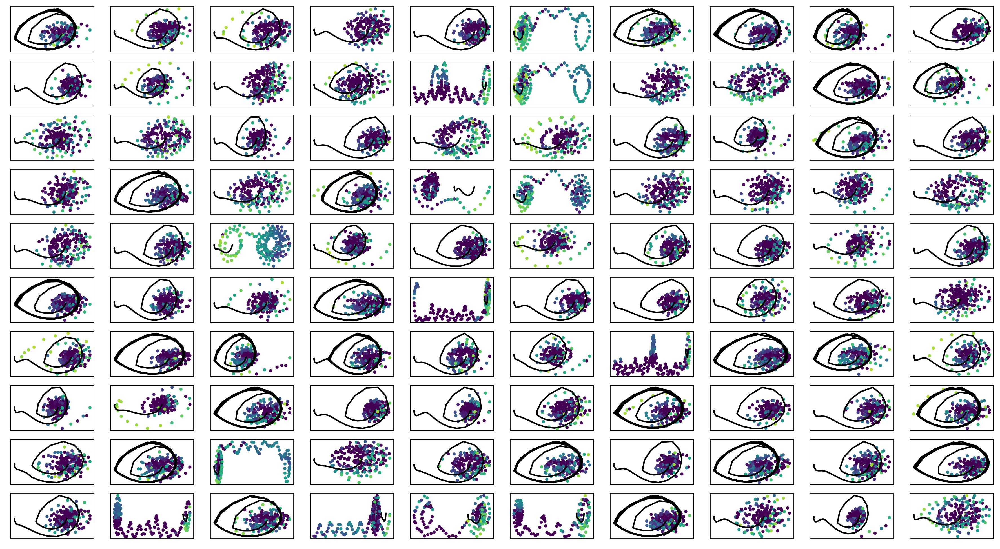

In [10]:

def f(x):
#     return x
    return np.log10(x)

fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter1.png")

In [11]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [12]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [13]:
for i in range(100):
    print(i, " ", end="")
    fig = plt.figure(figsize=(16,10), dpi=150)
    fig.patch.set_facecolor('white')
    plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
    plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
               vmin=-8, vmax=3
               )
    plt.colorbar()
    plt.savefig("ratio"+str(i)+".png")
    plt.close()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99  

train: iter 0  trainloss -136.09368  validloss -646.33683±0.00000  bestvalidloss -646.33683  last_update 0
train: iter 1  trainloss -140.97126  validloss -529.72314±0.00000  bestvalidloss -646.33683  last_update 1
train: iter 2  trainloss -144.50945  validloss -691.87448±0.00000  bestvalidloss -691.87448  last_update 0
train: iter 3  trainloss -147.49543  validloss -596.31171±0.00000  bestvalidloss -691.87448  last_update 1
train: iter 4  trainloss -149.44151  validloss -639.83451±0.00000  bestvalidloss -691.87448  last_update 2
train: iter 5  trainloss -151.02763  validloss -658.84310±0.00000  bestvalidloss -691.87448  last_update 3
train: iter 6  trainloss -147.20015  validloss -679.79226±0.00000  bestvalidloss -691.87448  last_update 4
train: iter 7  trainloss -155.06685  validloss -643.68759±0.00000  bestvalidloss -691.87448  last_update 5
train: iter 8  trainloss -151.81787  validloss -594.67967±0.00000  bestvalidloss -691.87448  last_update 6
train: iter 9  trainloss -152.98803  

train: iter 76  trainloss -154.79117  validloss -714.39389±0.00000  bestvalidloss -746.12205  last_update 31
train: iter 77  trainloss -161.77126  validloss -669.82659±0.00000  bestvalidloss -746.12205  last_update 32
train: iter 78  trainloss -161.99909  validloss -713.05021±0.00000  bestvalidloss -746.12205  last_update 33
train: iter 79  trainloss -162.05779  validloss -649.29577±0.00000  bestvalidloss -746.12205  last_update 34
train: iter 80  trainloss -150.56918  validloss -626.60689±0.00000  bestvalidloss -746.12205  last_update 35
train: iter 81  trainloss -146.61966  validloss -601.13005±0.00000  bestvalidloss -746.12205  last_update 36
train: iter 82  trainloss -165.02629  validloss -749.33259±0.00000  bestvalidloss -749.33259  last_update 0
train: iter 83  trainloss -163.40955  validloss -734.87320±0.00000  bestvalidloss -749.33259  last_update 1
train: iter 84  trainloss -164.68611  validloss -704.19175±0.00000  bestvalidloss -749.33259  last_update 2
train: iter 85  trainl

train: iter 151  trainloss -163.60645  validloss -757.41200±0.00000  bestvalidloss -789.18076  last_update 44
train: iter 152  trainloss -165.57056  validloss -696.30227±0.00000  bestvalidloss -789.18076  last_update 45
train: iter 153  trainloss -167.07896  validloss -682.73842±0.00000  bestvalidloss -789.18076  last_update 46
train: iter 154  trainloss -168.77700  validloss -701.32915±0.00000  bestvalidloss -789.18076  last_update 47
train: iter 155  trainloss -165.55082  validloss -676.15714±0.00000  bestvalidloss -789.18076  last_update 48
train: iter 156  trainloss -168.46925  validloss -766.62455±0.00000  bestvalidloss -789.18076  last_update 49
train: iter 157  trainloss -154.51293  validloss -745.79960±0.00000  bestvalidloss -789.18076  last_update 50
train: iter 158  trainloss -166.45176  validloss -766.49412±0.00000  bestvalidloss -789.18076  last_update 51
train: iter 159  trainloss -156.44298  validloss -785.70032±0.00000  bestvalidloss -789.18076  last_update 52
train: ite

train: iter 226  trainloss -169.72217  validloss -634.83058±0.00000  bestvalidloss -822.60176  last_update 48
train: iter 227  trainloss -169.46804  validloss -735.62243±0.00000  bestvalidloss -822.60176  last_update 49
train: iter 228  trainloss -163.72949  validloss -716.11562±0.00000  bestvalidloss -822.60176  last_update 50
train: iter 229  trainloss -146.30941  validloss -725.75149±0.00000  bestvalidloss -822.60176  last_update 51
train: iter 230  trainloss -162.64601  validloss -537.23754±0.00000  bestvalidloss -822.60176  last_update 52
train: iter 231  trainloss -162.23478  validloss -784.85731±0.00000  bestvalidloss -822.60176  last_update 53
train: iter 232  trainloss -162.18913  validloss -696.43690±0.00000  bestvalidloss -822.60176  last_update 54
train: iter 233  trainloss -165.85813  validloss -430.54765±0.00000  bestvalidloss -822.60176  last_update 55
train: iter 234  trainloss -164.21071  validloss -638.51277±0.00000  bestvalidloss -822.60176  last_update 56
train: ite

train: iter 301  trainloss -160.41383  validloss -294.22902±0.00000  bestvalidloss -831.42782  last_update 4
train: iter 302  trainloss -161.70289  validloss -670.52970±0.00000  bestvalidloss -831.42782  last_update 5
train: iter 303  trainloss -172.02440  validloss -776.62903±0.00000  bestvalidloss -831.42782  last_update 6
train: iter 304  trainloss -167.24097  validloss -787.67049±0.00000  bestvalidloss -831.42782  last_update 7
train: iter 305  trainloss -167.44996  validloss -686.02707±0.00000  bestvalidloss -831.42782  last_update 8
train: iter 306  trainloss -170.34816  validloss -724.72313±0.00000  bestvalidloss -831.42782  last_update 9
train: iter 307  trainloss -169.82646  validloss -714.22547±0.00000  bestvalidloss -831.42782  last_update 10
train: iter 308  trainloss -172.22222  validloss -638.65918±0.00000  bestvalidloss -831.42782  last_update 11
train: iter 309  trainloss -168.03429  validloss -707.81155±0.00000  bestvalidloss -831.42782  last_update 12
train: iter 310 

train: iter 376  trainloss -173.94868  validloss -588.89926±0.00000  bestvalidloss -831.42782  last_update 79
train: iter 377  trainloss -171.12106  validloss -728.38625±0.00000  bestvalidloss -831.42782  last_update 80
train: iter 378  trainloss -172.02938  validloss -739.04959±0.00000  bestvalidloss -831.42782  last_update 81
train: iter 379  trainloss -162.04703  validloss -747.72118±0.00000  bestvalidloss -831.42782  last_update 82
train: iter 380  trainloss -156.77697  validloss -596.26015±0.00000  bestvalidloss -831.42782  last_update 83
train: iter 381  trainloss -171.74903  validloss -792.57363±0.00000  bestvalidloss -831.42782  last_update 84
train: iter 382  trainloss -168.83569  validloss -734.51373±0.00000  bestvalidloss -831.42782  last_update 85
train: iter 383  trainloss -171.57974  validloss -527.34752±0.00000  bestvalidloss -831.42782  last_update 86
train: iter 384  trainloss -170.72563  validloss -668.80776±0.00000  bestvalidloss -831.42782  last_update 87
train: ite

train: iter 54  trainloss -171.53909  validloss -805.16177±0.00000  bestvalidloss -835.03654  last_update 13
train: iter 55  trainloss -148.44012  validloss -585.80053±0.00000  bestvalidloss -835.03654  last_update 14
train: iter 56  trainloss -151.73869  validloss -526.87642±0.00000  bestvalidloss -835.03654  last_update 15
train: iter 57  trainloss -172.05595  validloss -785.59487±0.00000  bestvalidloss -835.03654  last_update 16
train: iter 58  trainloss -170.86609  validloss -710.20264±0.00000  bestvalidloss -835.03654  last_update 17
train: iter 59  trainloss -165.18950  validloss -736.00765±0.00000  bestvalidloss -835.03654  last_update 18
train: iter 60  trainloss -174.43485  validloss -771.67371±0.00000  bestvalidloss -835.03654  last_update 19
train: iter 61  trainloss -170.12670  validloss -788.43665±0.00000  bestvalidloss -835.03654  last_update 20
train: iter 62  trainloss -168.25594  validloss -597.81009±0.00000  bestvalidloss -835.03654  last_update 21
train: iter 63  tra

train: iter 129  trainloss -171.25157  validloss -490.79799±0.00000  bestvalidloss -835.03654  last_update 88
train: iter 130  trainloss -173.57279  validloss -748.83256±0.00000  bestvalidloss -835.03654  last_update 89
train: iter 131  trainloss -174.04100  validloss -706.71144±0.00000  bestvalidloss -835.03654  last_update 90
train: iter 132  trainloss -169.32303  validloss -541.65643±0.00000  bestvalidloss -835.03654  last_update 91
train: iter 133  trainloss -168.87018  validloss -681.28596±0.00000  bestvalidloss -835.03654  last_update 92
train: iter 134  trainloss -167.52016  validloss -595.25862±0.00000  bestvalidloss -835.03654  last_update 93
train: iter 135  trainloss -175.13547  validloss -789.66975±0.00000  bestvalidloss -835.03654  last_update 94
train: iter 136  trainloss -172.72830  validloss -668.66249±0.00000  bestvalidloss -835.03654  last_update 95
train: iter 137  trainloss -166.90969  validloss -770.42319±0.00000  bestvalidloss -835.03654  last_update 96
train: ite

train: iter 62  trainloss -263.60117  validloss -1504.80500±0.00000  bestvalidloss -1623.01747  last_update 2
train: iter 63  trainloss -239.63003  validloss -1142.49983±0.00000  bestvalidloss -1623.01747  last_update 3
train: iter 64  trainloss -233.13800  validloss -1071.46116±0.00000  bestvalidloss -1623.01747  last_update 4
train: iter 65  trainloss -259.60667  validloss -345.27636±0.00000  bestvalidloss -1623.01747  last_update 5
train: iter 66  trainloss -329.87922  validloss -1329.50839±0.00000  bestvalidloss -1623.01747  last_update 6
train: iter 67  trainloss -258.10921  validloss -1015.20943±0.00000  bestvalidloss -1623.01747  last_update 7
train: iter 68  trainloss -278.97462  validloss -1071.26848±0.00000  bestvalidloss -1623.01747  last_update 8
train: iter 69  trainloss -331.10161  validloss -1356.65455±0.00000  bestvalidloss -1623.01747  last_update 9
train: iter 70  trainloss -326.11185  validloss -1611.86442±0.00000  bestvalidloss -1623.01747  last_update 10
train: ite

train: iter 136  trainloss -314.33639  validloss -1216.91403±0.00000  bestvalidloss -1667.25568  last_update 25
train: iter 137  trainloss -292.81010  validloss -1266.86088±0.00000  bestvalidloss -1667.25568  last_update 26
train: iter 138  trainloss -266.33675  validloss -1070.68654±0.00000  bestvalidloss -1667.25568  last_update 27
train: iter 139  trainloss -267.93209  validloss -1259.05109±0.00000  bestvalidloss -1667.25568  last_update 28
train: iter 140  trainloss -255.57450  validloss -1279.82343±0.00000  bestvalidloss -1667.25568  last_update 29
train: iter 141  trainloss -290.94536  validloss -1338.14033±0.00000  bestvalidloss -1667.25568  last_update 30
train: iter 142  trainloss -296.61362  validloss -1352.68367±0.00000  bestvalidloss -1667.25568  last_update 31
train: iter 143  trainloss -316.95107  validloss -1092.37246±0.00000  bestvalidloss -1667.25568  last_update 32
train: iter 144  trainloss -309.46205  validloss -1235.41347±0.00000  bestvalidloss -1667.25568  last_up

train: iter 210  trainloss -189.95988  validloss -687.59135±0.00000  bestvalidloss -1667.25568  last_update 99
train: iter 211  trainloss -247.80087  validloss -585.79771±0.00000  bestvalidloss -1667.25568  last_update 100
train: fin
alpha 0.5 vae_lr 0.0005


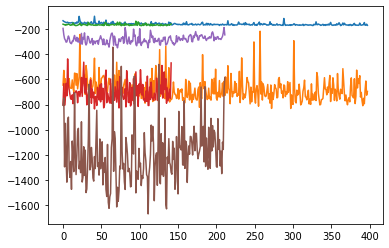

In [14]:
# iwvi.reset_encdec()
# iwvi.load_base()
# iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
# vae_lr=5e-4
# alpha=0.1
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

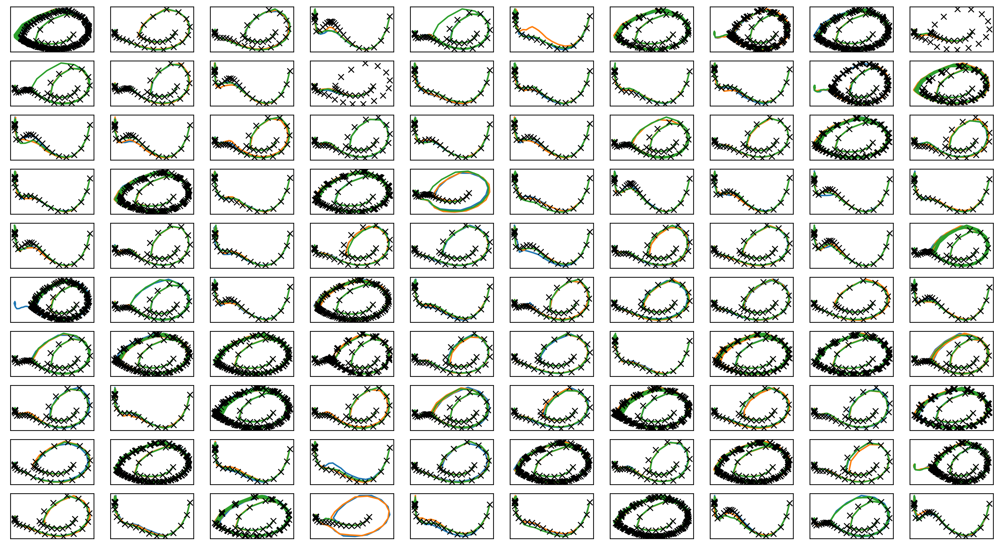

In [15]:
iwvi.get_sim_rollout_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter1.png")
print("実環境方策rollout vs Sim環境方策rollout")

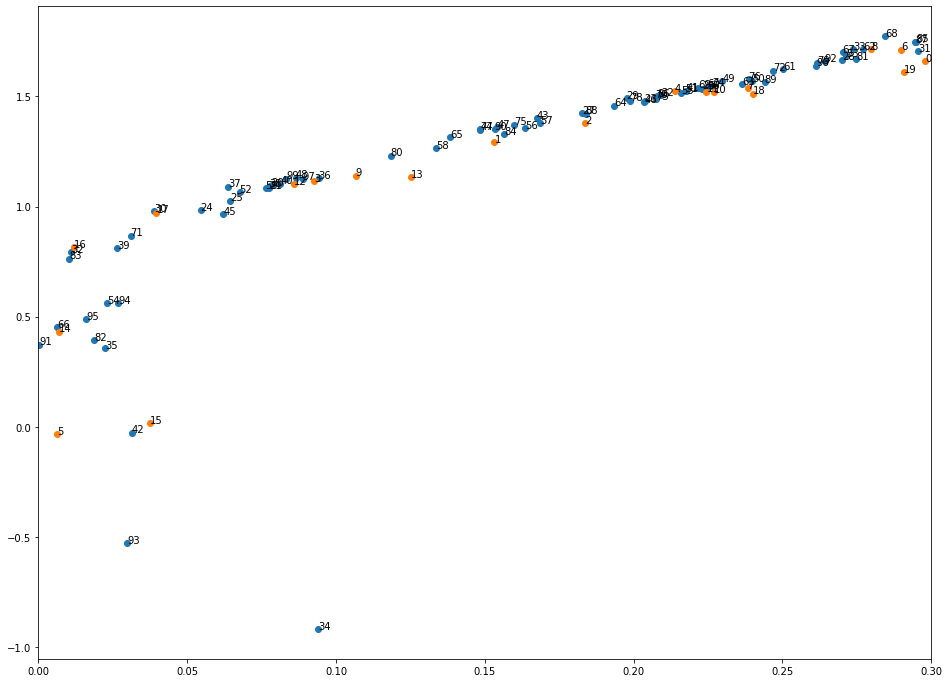

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [16]:
plt.figure(figsize=(16,12))
np_mulogvar = []
for i in range(len(iwvi.mulogvar_list_for_mixture_of_gaussian_belief)):
    np_mulogvar.append(iwvi.mulogvar_list_for_mixture_of_gaussian_belief[i].numpy())
np_mulogvar = np.array(np_mulogvar)

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

# Iter2

In [17]:
iwvi.get_sim_rollout_data_randomlen()


0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [18]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.17381  validloss 0.37887±0.00000  bestvalidloss 0.37887  last_update 0
train: iter 1  trainloss 0.12536  validloss 0.16260±0.00000  bestvalidloss 0.16260  last_update 0
train: iter 2  trainloss 0.12372  validloss 0.15610±0.00000  bestvalidloss 0.15610  last_update 0
train: iter 3  trainloss 0.11865  validloss 0.13917±0.00000  bestvalidloss 0.13917  last_update 0
train: iter 4  trainloss 0.12138  validloss 0.14457±0.00000  bestvalidloss 0.13917  last_update 1
train: iter 5  trainloss 0.10884  validloss 0.13369±0.00000  bestvalidloss 0.13369  last_update 0
train: iter 6  trainloss 0.11729  validloss 0.13373±0.00000  bestvalidloss 0.13369  last_update 1
train: iter 7  trainloss 0.11142  validloss 0.12876±0.00000  bestvalidloss 0.12876  last_update 0
train: iter 8  trainloss 0.10633  validloss 0.12823±0.00000  bestvalidloss 0.12823  last_update 0
train: iter 9  trainloss 0.10432  validloss 0.13580±0.00000  bestvalidloss 0.12823  last_update 1
train: iter 10  trai

train: iter 83  trainloss 0.09051  validloss 0.10700±0.00000  bestvalidloss 0.10700  last_update 0
train: iter 84  trainloss 0.08974  validloss 0.10846±0.00000  bestvalidloss 0.10700  last_update 1
train: iter 85  trainloss 0.09418  validloss 0.10388±0.00000  bestvalidloss 0.10388  last_update 0
train: iter 86  trainloss 0.09667  validloss 0.11436±0.00000  bestvalidloss 0.10388  last_update 1
train: iter 87  trainloss 0.09199  validloss 0.10322±0.00000  bestvalidloss 0.10322  last_update 0
train: iter 88  trainloss 0.09111  validloss 0.11815±0.00000  bestvalidloss 0.10322  last_update 1
train: iter 89  trainloss 0.14886  validloss 0.11071±0.00000  bestvalidloss 0.10322  last_update 2
train: iter 90  trainloss 0.09612  validloss 0.11265±0.00000  bestvalidloss 0.10322  last_update 3
train: iter 91  trainloss 0.08872  validloss 0.10589±0.00000  bestvalidloss 0.10322  last_update 4
train: iter 92  trainloss 0.09973  validloss 0.10420±0.00000  bestvalidloss 0.10322  last_update 5
train: ite

train: iter 165  trainloss 0.08574  validloss 0.09967±0.00000  bestvalidloss 0.09951  last_update 15
train: iter 166  trainloss 0.08600  validloss 0.10143±0.00000  bestvalidloss 0.09951  last_update 16
train: iter 167  trainloss 0.08512  validloss 0.10221±0.00000  bestvalidloss 0.09951  last_update 17
train: iter 168  trainloss 0.08997  validloss 0.10105±0.00000  bestvalidloss 0.09951  last_update 18
train: iter 169  trainloss 0.08545  validloss 0.09845±0.00000  bestvalidloss 0.09845  last_update 0
train: iter 170  trainloss 0.08990  validloss 0.10225±0.00000  bestvalidloss 0.09845  last_update 1
train: iter 171  trainloss 0.08598  validloss 0.10920±0.00000  bestvalidloss 0.09845  last_update 2
train: iter 172  trainloss 0.08721  validloss 0.10183±0.00000  bestvalidloss 0.09845  last_update 3
train: iter 173  trainloss 0.08290  validloss 0.10180±0.00000  bestvalidloss 0.09845  last_update 4
train: iter 174  trainloss 0.08403  validloss 0.10655±0.00000  bestvalidloss 0.09845  last_updat

train: iter 247  trainloss 0.09626  validloss 0.09422±0.00000  bestvalidloss 0.09422  last_update 0
train: iter 248  trainloss 0.08393  validloss 0.10592±0.00000  bestvalidloss 0.09422  last_update 1
train: iter 249  trainloss 0.08187  validloss 0.11474±0.00000  bestvalidloss 0.09422  last_update 2
train: iter 250  trainloss 0.08390  validloss 0.09941±0.00000  bestvalidloss 0.09422  last_update 3
train: iter 251  trainloss 0.08245  validloss 0.09803±0.00000  bestvalidloss 0.09422  last_update 4
train: iter 252  trainloss 0.08601  validloss 0.12136±0.00000  bestvalidloss 0.09422  last_update 5
train: iter 253  trainloss 0.08112  validloss 0.09590±0.00000  bestvalidloss 0.09422  last_update 6
train: iter 254  trainloss 0.07868  validloss 0.10125±0.00000  bestvalidloss 0.09422  last_update 7
train: iter 255  trainloss 0.07614  validloss 0.09593±0.00000  bestvalidloss 0.09422  last_update 8
train: iter 256  trainloss 0.07676  validloss 0.10020±0.00000  bestvalidloss 0.09422  last_update 9


train: iter 329  trainloss 0.08225  validloss 0.10410±0.00000  bestvalidloss 0.09260  last_update 17
train: iter 330  trainloss 0.07941  validloss 0.11333±0.00000  bestvalidloss 0.09260  last_update 18
train: iter 331  trainloss 0.08493  validloss 0.12612±0.00000  bestvalidloss 0.09260  last_update 19
train: iter 332  trainloss 0.07560  validloss 0.09724±0.00000  bestvalidloss 0.09260  last_update 20
train: iter 333  trainloss 0.08421  validloss 0.09437±0.00000  bestvalidloss 0.09260  last_update 21
train: iter 334  trainloss 0.08127  validloss 0.09494±0.00000  bestvalidloss 0.09260  last_update 22
train: iter 335  trainloss 0.07245  validloss 0.09722±0.00000  bestvalidloss 0.09260  last_update 23
train: iter 336  trainloss 0.07422  validloss 0.10116±0.00000  bestvalidloss 0.09260  last_update 24
train: iter 337  trainloss 0.07678  validloss 0.10805±0.00000  bestvalidloss 0.09260  last_update 25
train: iter 338  trainloss 0.07367  validloss 0.10573±0.00000  bestvalidloss 0.09260  last_

train: iter 411  trainloss 0.07031  validloss 0.09840±0.00000  bestvalidloss 0.09220  last_update 5
train: iter 412  trainloss 0.07097  validloss 0.09580±0.00000  bestvalidloss 0.09220  last_update 6
train: iter 413  trainloss 0.07119  validloss 0.10313±0.00000  bestvalidloss 0.09220  last_update 7
train: iter 414  trainloss 0.07240  validloss 0.10266±0.00000  bestvalidloss 0.09220  last_update 8
train: iter 415  trainloss 0.07500  validloss 0.10914±0.00000  bestvalidloss 0.09220  last_update 9
train: iter 416  trainloss 0.07358  validloss 0.10373±0.00000  bestvalidloss 0.09220  last_update 10
train: iter 417  trainloss 0.07006  validloss 0.09689±0.00000  bestvalidloss 0.09220  last_update 11
train: iter 418  trainloss 0.07125  validloss 0.10133±0.00000  bestvalidloss 0.09220  last_update 12
train: iter 419  trainloss 0.07731  validloss 0.10173±0.00000  bestvalidloss 0.09220  last_update 13
train: iter 420  trainloss 0.08272  validloss 0.09841±0.00000  bestvalidloss 0.09220  last_updat

train: iter 493  trainloss 0.07144  validloss 0.10250±0.00000  bestvalidloss 0.09013  last_update 63
train: iter 494  trainloss 0.07699  validloss 0.10766±0.00000  bestvalidloss 0.09013  last_update 64
train: iter 495  trainloss 0.07096  validloss 0.10704±0.00000  bestvalidloss 0.09013  last_update 65
train: iter 496  trainloss 0.06804  validloss 0.09089±0.00000  bestvalidloss 0.09013  last_update 66
train: iter 497  trainloss 0.06811  validloss 0.09428±0.00000  bestvalidloss 0.09013  last_update 67
train: iter 498  trainloss 0.07814  validloss 0.10674±0.00000  bestvalidloss 0.09013  last_update 68
train: iter 499  trainloss 0.07114  validloss 0.11504±0.00000  bestvalidloss 0.09013  last_update 69
train: iter 500  trainloss 0.06967  validloss 0.09149±0.00000  bestvalidloss 0.09013  last_update 70
train: iter 501  trainloss 0.08695  validloss 0.10475±0.00000  bestvalidloss 0.09013  last_update 71
train: iter 502  trainloss 0.06664  validloss 0.09302±0.00000  bestvalidloss 0.09013  last_

1e-08 1000.0


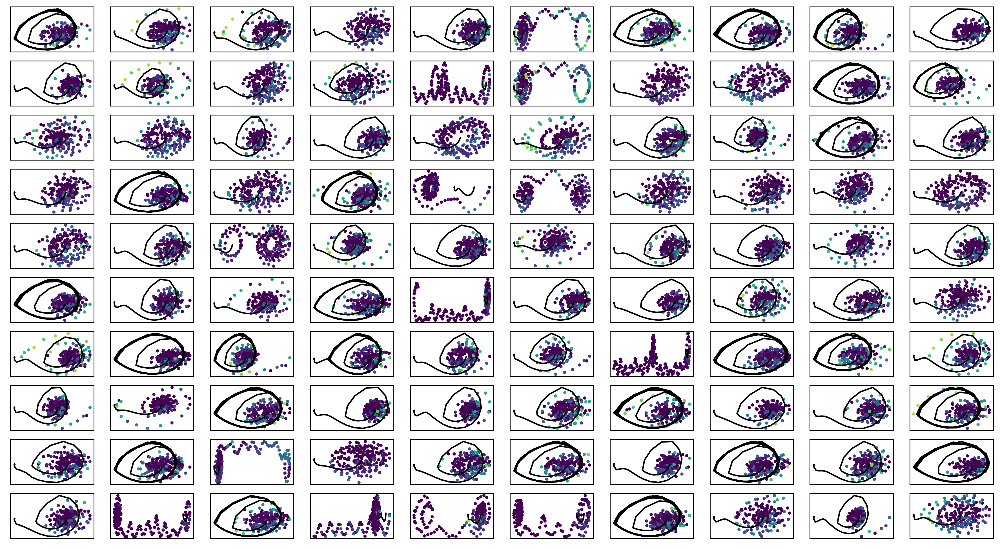

In [19]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter2.png")

In [20]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [21]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train: iter 0  trainloss -43.70766  validloss -357.96058±0.00000  bestvalidloss -357.96058  last_update 0
train: iter 1  trainloss -47.01996  validloss -362.33124±0.00000  bestvalidloss -362.33124  last_update 0
train: iter 2  trainloss -20.69737  validloss -282.38057±0.00000  bestvalidloss -362.33124  last_update 1
train: iter 3  trainloss -48.44809  validloss -340.94344±0.00000  bestvalidloss -362.33124  last_update 2
train: iter 4  trainloss -48.08149  validloss -380.07153±0.00000  bestvalidloss -380.07153  last_update 0
train: iter 5  trainloss -48.40268  validloss -333.46437±0.00000  bestvalidloss -380.07153  last_update 1
train: iter 6  trainloss -45.37346  validloss -325.54718±0.00000  bestvalidloss -380.07153  last_update 2
train: iter 7  trainloss -50.16907  validloss -367.71582±0.00000  bestvalidloss -380.07153  last_update 3
train: iter 8  trainloss -46.71448  validloss -344.09589±0.00000  bestvalidloss -380.07153  last_update 4
train: iter 9  trainloss -50.27895  validloss 

train: iter 77  trainloss -49.26907  validloss -291.75303±0.00000  bestvalidloss -381.65842  last_update 54
train: iter 78  trainloss -46.78413  validloss -312.63843±0.00000  bestvalidloss -381.65842  last_update 55
train: iter 79  trainloss -46.78357  validloss -268.54805±0.00000  bestvalidloss -381.65842  last_update 56
train: iter 80  trainloss -49.80513  validloss -355.85199±0.00000  bestvalidloss -381.65842  last_update 57
train: iter 81  trainloss -52.31934  validloss -360.82049±0.00000  bestvalidloss -381.65842  last_update 58
train: iter 82  trainloss -51.31058  validloss -270.51597±0.00000  bestvalidloss -381.65842  last_update 59
train: iter 83  trainloss -48.66515  validloss -353.79632±0.00000  bestvalidloss -381.65842  last_update 60
train: iter 84  trainloss 129.43921  validloss -114.21972±0.00000  bestvalidloss -381.65842  last_update 61
train: iter 85  trainloss -24.65952  validloss 256.99923±0.00000  bestvalidloss -381.65842  last_update 62
train: iter 86  trainloss -46

train: iter 153  trainloss -49.11382  validloss -226.08559±0.00000  bestvalidloss -381.94549  last_update 40
train: iter 154  trainloss -51.61886  validloss -368.50099±0.00000  bestvalidloss -381.94549  last_update 41
train: iter 155  trainloss -45.63397  validloss -367.35049±0.00000  bestvalidloss -381.94549  last_update 42
train: iter 156  trainloss -36.07427  validloss -114.77637±0.00000  bestvalidloss -381.94549  last_update 43
train: iter 157  trainloss -42.97608  validloss -243.62319±0.00000  bestvalidloss -381.94549  last_update 44
train: iter 158  trainloss -50.37276  validloss -372.50186±0.00000  bestvalidloss -381.94549  last_update 45
train: iter 159  trainloss -50.67069  validloss -357.14982±0.00000  bestvalidloss -381.94549  last_update 46
train: iter 160  trainloss -49.11230  validloss -295.73592±0.00000  bestvalidloss -381.94549  last_update 47
train: iter 161  trainloss -49.89479  validloss -363.53450±0.00000  bestvalidloss -381.94549  last_update 48
train: iter 162  tr

train: iter 229  trainloss 79.86361  validloss 236.36676±0.00000  bestvalidloss -387.28457  last_update 18
train: iter 230  trainloss -46.78886  validloss -274.33122±0.00000  bestvalidloss -387.28457  last_update 19
train: iter 231  trainloss -48.92961  validloss -341.73717±0.00000  bestvalidloss -387.28457  last_update 20
train: iter 232  trainloss -49.97416  validloss -340.78755±0.00000  bestvalidloss -387.28457  last_update 21
train: iter 233  trainloss -50.03970  validloss -350.79367±0.00000  bestvalidloss -387.28457  last_update 22
train: iter 234  trainloss -50.92240  validloss -344.97048±0.00000  bestvalidloss -387.28457  last_update 23
train: iter 235  trainloss -51.16711  validloss -368.21901±0.00000  bestvalidloss -387.28457  last_update 24
train: iter 236  trainloss -40.65860  validloss -371.45193±0.00000  bestvalidloss -387.28457  last_update 25
train: iter 237  trainloss -49.98003  validloss -341.26091±0.00000  bestvalidloss -387.28457  last_update 26
train: iter 238  trai

train: iter 305  trainloss -51.30600  validloss -366.36120±0.00000  bestvalidloss -387.28457  last_update 94
train: iter 306  trainloss -51.82814  validloss -360.08028±0.00000  bestvalidloss -387.28457  last_update 95
train: iter 307  trainloss -38.43399  validloss -323.43648±0.00000  bestvalidloss -387.28457  last_update 96
train: iter 308  trainloss -49.75647  validloss -362.33150±0.00000  bestvalidloss -387.28457  last_update 97
train: iter 309  trainloss -51.41346  validloss -359.40022±0.00000  bestvalidloss -387.28457  last_update 98
train: iter 310  trainloss -51.23337  validloss -378.98445±0.00000  bestvalidloss -387.28457  last_update 99
train: iter 311  trainloss -50.02685  validloss -336.25875±0.00000  bestvalidloss -387.28457  last_update 100
train: fin
train: iter 0  trainloss -43.77609  validloss -370.26313±0.00000  bestvalidloss -370.26313  last_update 0
train: iter 1  trainloss -49.34268  validloss -345.52692±0.00000  bestvalidloss -370.26313  last_update 1
train: iter 2

train: iter 69  trainloss -51.93427  validloss -328.10120±0.00000  bestvalidloss -387.77966  last_update 67
train: iter 70  trainloss -48.76094  validloss -321.17981±0.00000  bestvalidloss -387.77966  last_update 68
train: iter 71  trainloss -43.17566  validloss -237.19068±0.00000  bestvalidloss -387.77966  last_update 69
train: iter 72  trainloss -51.90593  validloss -341.81359±0.00000  bestvalidloss -387.77966  last_update 70
train: iter 73  trainloss -45.60591  validloss -274.12276±0.00000  bestvalidloss -387.77966  last_update 71
train: iter 74  trainloss -48.27825  validloss -204.73538±0.00000  bestvalidloss -387.77966  last_update 72
train: iter 75  trainloss -37.07246  validloss -333.85873±0.00000  bestvalidloss -387.77966  last_update 73
train: iter 76  trainloss -30.57836  validloss -333.95026±0.00000  bestvalidloss -387.77966  last_update 74
train: iter 77  trainloss -43.78046  validloss 62.84486±0.00000  bestvalidloss -387.77966  last_update 75
train: iter 78  trainloss -47.

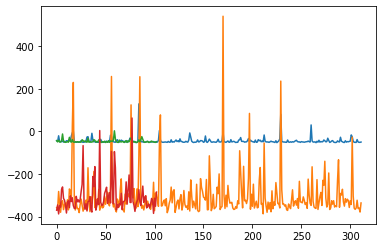

In [22]:
# iwvi.reset_encdec()
# iwvi.load_base()
# iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
# vae_lr=5e-4
# alpha=0.1
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

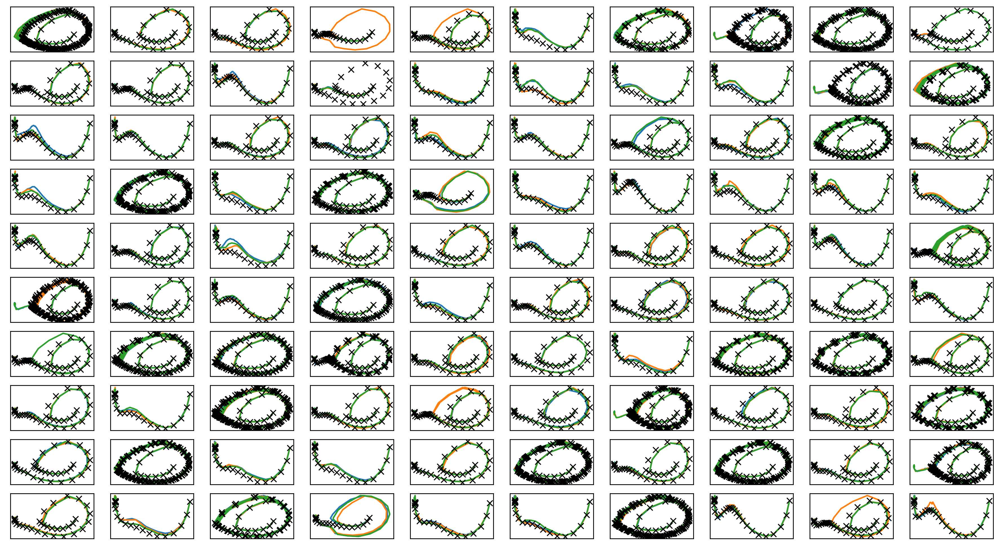

In [23]:
iwvi.get_sim_rollout_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter2.png")
print("実環境方策rollout vs Sim環境方策rollout")

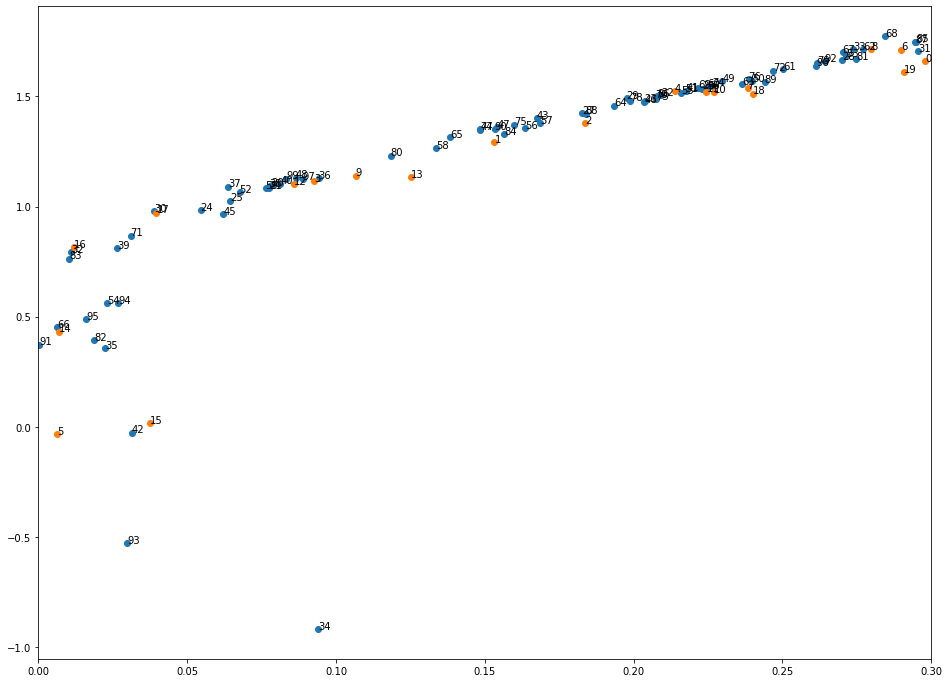

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [24]:
plt.figure(figsize=(16,12))
np_mulogvar = []
for i in range(len(iwvi.mulogvar_list_for_mixture_of_gaussian_belief)):
    np_mulogvar.append(iwvi.mulogvar_list_for_mixture_of_gaussian_belief[i].numpy())
np_mulogvar = np.array(np_mulogvar)

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

# Iter 3

In [25]:
iwvi.get_sim_rollout_data_randomlen()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [26]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)



train: iter 0  trainloss 0.08254  validloss 0.12702±0.00000  bestvalidloss 0.12702  last_update 0
train: iter 1  trainloss 0.08288  validloss 0.12443±0.00000  bestvalidloss 0.12443  last_update 0
train: iter 2  trainloss 0.08228  validloss 0.14282±0.00000  bestvalidloss 0.12443  last_update 1
train: iter 3  trainloss 0.07264  validloss 0.12880±0.00000  bestvalidloss 0.12443  last_update 2
train: iter 4  trainloss 0.07512  validloss 0.12987±0.00000  bestvalidloss 0.12443  last_update 3
train: iter 5  trainloss 0.07230  validloss 0.12452±0.00000  bestvalidloss 0.12443  last_update 4
train: iter 6  trainloss 0.07347  validloss 0.12414±0.00000  bestvalidloss 0.12414  last_update 0
train: iter 7  trainloss 0.07764  validloss 0.12605±0.00000  bestvalidloss 0.12414  last_update 1
train: iter 8  trainloss 0.07780  validloss 0.11894±0.00000  bestvalidloss 0.11894  last_update 0
train: iter 9  trainloss 0.07930  validloss 0.14253±0.00000  bestvalidloss 0.11894  last_update 1
train: iter 10  trai

train: iter 83  trainloss 0.07911  validloss 0.11448±0.00000  bestvalidloss 0.11081  last_update 2
train: iter 84  trainloss 0.07899  validloss 0.13397±0.00000  bestvalidloss 0.11081  last_update 3
train: iter 85  trainloss 0.07374  validloss 0.11910±0.00000  bestvalidloss 0.11081  last_update 4
train: iter 86  trainloss 0.07282  validloss 0.10810±0.00000  bestvalidloss 0.10810  last_update 0
train: iter 87  trainloss 0.07152  validloss 0.12598±0.00000  bestvalidloss 0.10810  last_update 1
train: iter 88  trainloss 0.07184  validloss 0.11963±0.00000  bestvalidloss 0.10810  last_update 2
train: iter 89  trainloss 0.06989  validloss 0.11390±0.00000  bestvalidloss 0.10810  last_update 3
train: iter 90  trainloss 0.06970  validloss 0.13126±0.00000  bestvalidloss 0.10810  last_update 4
train: iter 91  trainloss 0.07271  validloss 0.11825±0.00000  bestvalidloss 0.10810  last_update 5
train: iter 92  trainloss 0.06935  validloss 0.11944±0.00000  bestvalidloss 0.10810  last_update 6
train: ite

train: iter 165  trainloss 0.06879  validloss 0.11447±0.00000  bestvalidloss 0.10548  last_update 12
train: iter 166  trainloss 0.06804  validloss 0.11245±0.00000  bestvalidloss 0.10548  last_update 13
train: iter 167  trainloss 0.07598  validloss 0.11927±0.00000  bestvalidloss 0.10548  last_update 14
train: iter 168  trainloss 0.07582  validloss 0.11867±0.00000  bestvalidloss 0.10548  last_update 15
train: iter 169  trainloss 0.06674  validloss 0.10335±0.00000  bestvalidloss 0.10335  last_update 0
train: iter 170  trainloss 0.06739  validloss 0.12093±0.00000  bestvalidloss 0.10335  last_update 1
train: iter 171  trainloss 0.06622  validloss 0.11144±0.00000  bestvalidloss 0.10335  last_update 2
train: iter 172  trainloss 0.07353  validloss 0.11841±0.00000  bestvalidloss 0.10335  last_update 3
train: iter 173  trainloss 0.06648  validloss 0.12026±0.00000  bestvalidloss 0.10335  last_update 4
train: iter 174  trainloss 0.06714  validloss 0.11362±0.00000  bestvalidloss 0.10335  last_updat

train: iter 247  trainloss 0.06679  validloss 0.11270±0.00000  bestvalidloss 0.10271  last_update 6
train: iter 248  trainloss 0.06864  validloss 0.10945±0.00000  bestvalidloss 0.10271  last_update 7
train: iter 249  trainloss 0.06502  validloss 0.12002±0.00000  bestvalidloss 0.10271  last_update 8
train: iter 250  trainloss 0.06763  validloss 0.11465±0.00000  bestvalidloss 0.10271  last_update 9
train: iter 251  trainloss 0.06545  validloss 0.11371±0.00000  bestvalidloss 0.10271  last_update 10
train: iter 252  trainloss 0.06826  validloss 0.10686±0.00000  bestvalidloss 0.10271  last_update 11
train: iter 253  trainloss 0.06876  validloss 0.10758±0.00000  bestvalidloss 0.10271  last_update 12
train: iter 254  trainloss 0.06566  validloss 0.10604±0.00000  bestvalidloss 0.10271  last_update 13
train: iter 255  trainloss 0.06516  validloss 0.11209±0.00000  bestvalidloss 0.10271  last_update 14
train: iter 256  trainloss 0.06439  validloss 0.11224±0.00000  bestvalidloss 0.10271  last_upda

train: iter 329  trainloss 0.06440  validloss 0.11038±0.00000  bestvalidloss 0.10271  last_update 88
train: iter 330  trainloss 0.06510  validloss 0.10824±0.00000  bestvalidloss 0.10271  last_update 89
train: iter 331  trainloss 0.06498  validloss 0.10866±0.00000  bestvalidloss 0.10271  last_update 90
train: iter 332  trainloss 0.08437  validloss 0.11412±0.00000  bestvalidloss 0.10271  last_update 91
train: iter 333  trainloss 0.07481  validloss 0.11362±0.00000  bestvalidloss 0.10271  last_update 92
train: iter 334  trainloss 0.06371  validloss 0.10408±0.00000  bestvalidloss 0.10271  last_update 93
train: iter 335  trainloss 0.06359  validloss 0.10923±0.00000  bestvalidloss 0.10271  last_update 94
train: iter 336  trainloss 0.06411  validloss 0.13980±0.00000  bestvalidloss 0.10271  last_update 95
train: iter 337  trainloss 0.06356  validloss 0.11250±0.00000  bestvalidloss 0.10271  last_update 96
train: iter 338  trainloss 0.06269  validloss 0.11431±0.00000  bestvalidloss 0.10271  last_

1e-08 1000.0


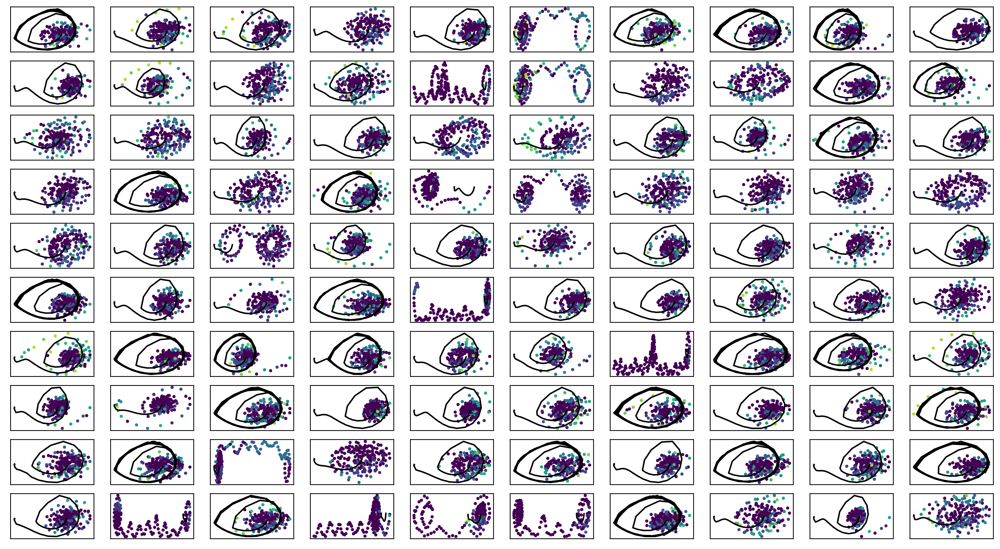

In [27]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter3.png")

In [28]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [29]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [30]:
# i = 49
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train: iter 0  trainloss -70.15303  validloss -674.14873±0.00000  bestvalidloss -674.14873  last_update 0
train: iter 1  trainloss -73.58009  validloss -498.36794±0.00000  bestvalidloss -674.14873  last_update 1
train: iter 2  trainloss -75.66326  validloss -632.39756±0.00000  bestvalidloss -674.14873  last_update 2
train: iter 3  trainloss -75.74707  validloss -514.65441±0.00000  bestvalidloss -674.14873  last_update 3
train: iter 4  trainloss -60.85021  validloss -604.49806±0.00000  bestvalidloss -674.14873  last_update 4
train: iter 5  trainloss -76.37750  validloss -612.51199±0.00000  bestvalidloss -674.14873  last_update 5
train: iter 6  trainloss -61.92396  validloss -587.99247±0.00000  bestvalidloss -674.14873  last_update 6
train: iter 7  trainloss -76.44098  validloss -586.16748±0.00000  bestvalidloss -674.14873  last_update 7
train: iter 8  trainloss -72.78417  validloss -704.04257±0.00000  bestvalidloss -704.04257  last_update 0
train: iter 9  trainloss -79.00046  validloss 

train: iter 77  trainloss -74.37783  validloss -562.51436±0.00000  bestvalidloss -704.04257  last_update 69
train: iter 78  trainloss -69.23633  validloss -536.92659±0.00000  bestvalidloss -704.04257  last_update 70
train: iter 79  trainloss -78.15243  validloss -551.49476±0.00000  bestvalidloss -704.04257  last_update 71
train: iter 80  trainloss -78.61433  validloss -414.05582±0.00000  bestvalidloss -704.04257  last_update 72
train: iter 81  trainloss -78.27610  validloss -658.31077±0.00000  bestvalidloss -704.04257  last_update 73
train: iter 82  trainloss -72.57036  validloss -495.31929±0.00000  bestvalidloss -704.04257  last_update 74
train: iter 83  trainloss -75.73284  validloss -478.13133±0.00000  bestvalidloss -704.04257  last_update 75
train: iter 84  trainloss -81.10057  validloss -583.75612±0.00000  bestvalidloss -704.04257  last_update 76
train: iter 85  trainloss -70.68831  validloss -524.94042±0.00000  bestvalidloss -704.04257  last_update 77
train: iter 86  trainloss -7

train: iter 44  trainloss -73.05547  validloss -311.68220±0.00000  bestvalidloss -685.01161  last_update 36
train: iter 45  trainloss -77.70170  validloss -563.56390±0.00000  bestvalidloss -685.01161  last_update 37
train: iter 46  trainloss -74.12863  validloss -556.08474±0.00000  bestvalidloss -685.01161  last_update 38
train: iter 47  trainloss -78.61502  validloss -595.27777±0.00000  bestvalidloss -685.01161  last_update 39
train: iter 48  trainloss -73.14564  validloss -495.40953±0.00000  bestvalidloss -685.01161  last_update 40
train: iter 49  trainloss -76.62065  validloss -526.51607±0.00000  bestvalidloss -685.01161  last_update 41
train: iter 50  trainloss -71.58302  validloss -602.28624±0.00000  bestvalidloss -685.01161  last_update 42
train: iter 51  trainloss -79.19613  validloss -631.12246±0.00000  bestvalidloss -685.01161  last_update 43
train: iter 52  trainloss -70.43312  validloss -556.57773±0.00000  bestvalidloss -685.01161  last_update 44
train: iter 53  trainloss -6

train: iter 11  trainloss -101.64138  validloss -693.08615±0.00000  bestvalidloss -760.41214  last_update 4
train: iter 12  trainloss -97.24701  validloss -821.82863±0.00000  bestvalidloss -821.82863  last_update 0
train: iter 13  trainloss -93.60451  validloss -435.69218±0.00000  bestvalidloss -821.82863  last_update 1
train: iter 14  trainloss -83.82502  validloss -571.89377±0.00000  bestvalidloss -821.82863  last_update 2
train: iter 15  trainloss -26.92016  validloss -772.71092±0.00000  bestvalidloss -821.82863  last_update 3
train: iter 16  trainloss -90.52060  validloss -616.63514±0.00000  bestvalidloss -821.82863  last_update 4
train: iter 17  trainloss -93.49017  validloss -707.80293±0.00000  bestvalidloss -821.82863  last_update 5
train: iter 18  trainloss -95.34980  validloss -596.67258±0.00000  bestvalidloss -821.82863  last_update 6
train: iter 19  trainloss -106.51730  validloss -715.58815±0.00000  bestvalidloss -821.82863  last_update 7
train: iter 20  trainloss -99.19675

train: iter 87  trainloss -65.06858  validloss -508.22371±0.00000  bestvalidloss -821.82863  last_update 75
train: iter 88  trainloss -61.60991  validloss -472.71297±0.00000  bestvalidloss -821.82863  last_update 76
train: iter 89  trainloss -44.62367  validloss -254.38039±0.00000  bestvalidloss -821.82863  last_update 77
train: iter 90  trainloss -69.17994  validloss -539.73482±0.00000  bestvalidloss -821.82863  last_update 78
train: iter 91  trainloss -78.71459  validloss -565.45995±0.00000  bestvalidloss -821.82863  last_update 79
train: iter 92  trainloss -72.31126  validloss -554.46441±0.00000  bestvalidloss -821.82863  last_update 80
train: iter 93  trainloss -173.59819  validloss -257.19436±0.00000  bestvalidloss -821.82863  last_update 81
train: iter 94  trainloss -162.80301  validloss -876.75449±0.00000  bestvalidloss -876.75449  last_update 0
train: iter 95  trainloss -160.18702  validloss -730.85394±0.00000  bestvalidloss -876.75449  last_update 1
train: iter 96  trainloss -

train: iter 163  trainloss -41.10145  validloss -441.69060±0.00000  bestvalidloss -876.75449  last_update 69
train: iter 164  trainloss -42.87118  validloss -429.68256±0.00000  bestvalidloss -876.75449  last_update 70
train: iter 165  trainloss -47.00547  validloss -465.43649±0.00000  bestvalidloss -876.75449  last_update 71
train: iter 166  trainloss -43.97710  validloss -481.10341±0.00000  bestvalidloss -876.75449  last_update 72
train: iter 167  trainloss -40.84408  validloss -351.01512±0.00000  bestvalidloss -876.75449  last_update 73
train: iter 168  trainloss -43.71619  validloss -177.04255±0.00000  bestvalidloss -876.75449  last_update 74
train: iter 169  trainloss -63.67117  validloss -451.15323±0.00000  bestvalidloss -876.75449  last_update 75
train: iter 170  trainloss -54.90452  validloss -498.11917±0.00000  bestvalidloss -876.75449  last_update 76
train: iter 171  trainloss -55.94241  validloss -519.54149±0.00000  bestvalidloss -876.75449  last_update 77
train: iter 172  tr

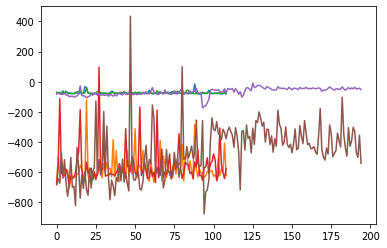

In [31]:
# iwvi.reset_encdec()
# iwvi.load_base()
# iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
# vae_lr=5e-4
# alpha=0.1
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

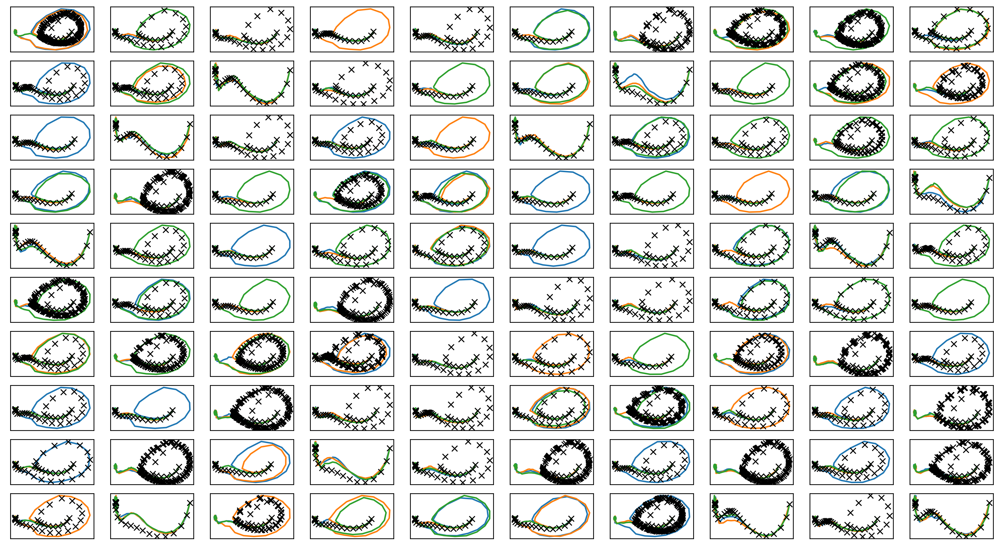

In [32]:
iwvi.get_sim_rollout_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter3.png")
print("実環境方策rollout vs Sim環境方策rollout")

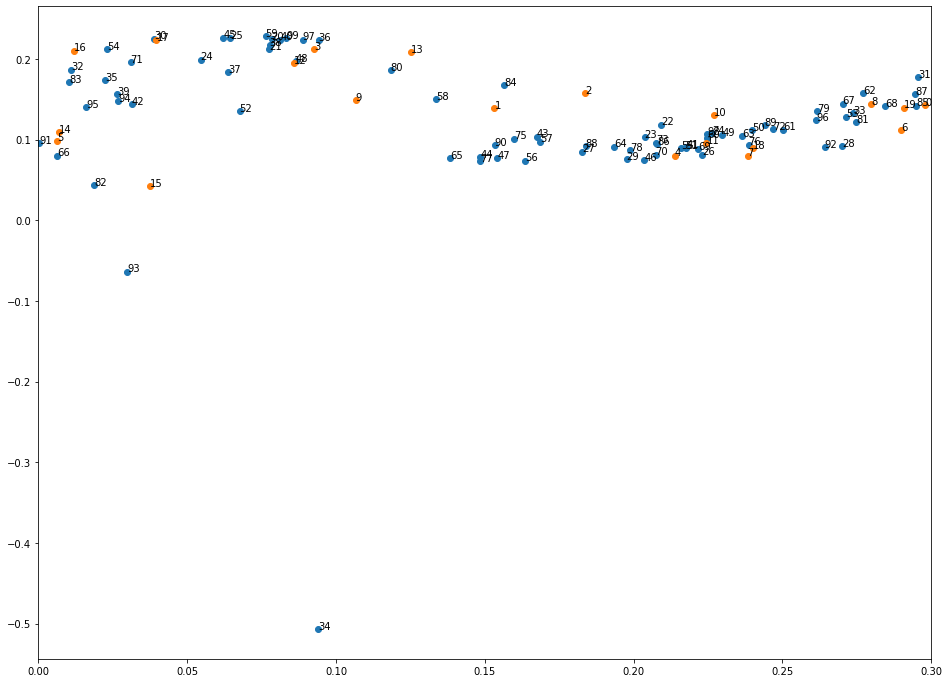

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [33]:
plt.figure(figsize=(16,12))
np_mulogvar = []
for i in range(len(iwvi.mulogvar_list_for_mixture_of_gaussian_belief)):
    np_mulogvar.append(iwvi.mulogvar_list_for_mixture_of_gaussian_belief[i].numpy())
np_mulogvar = np.array(np_mulogvar)

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

# Iter 4

In [34]:
iwvi.get_sim_rollout_data_randomlen()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [35]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.42337  validloss 0.86735±0.00000  bestvalidloss 0.86735  last_update 0
train: iter 1  trainloss 0.21608  validloss 0.27469±0.00000  bestvalidloss 0.27469  last_update 0
train: iter 2  trainloss 0.17891  validloss 0.23339±0.00000  bestvalidloss 0.23339  last_update 0
train: iter 3  trainloss 0.15950  validloss 0.21514±0.00000  bestvalidloss 0.21514  last_update 0
train: iter 4  trainloss 0.13428  validloss 0.17954±0.00000  bestvalidloss 0.17954  last_update 0
train: iter 5  trainloss 0.12761  validloss 0.17824±0.00000  bestvalidloss 0.17824  last_update 0
train: iter 6  trainloss 0.11314  validloss 0.15771±0.00000  bestvalidloss 0.15771  last_update 0
train: iter 7  trainloss 0.11142  validloss 0.16853±0.00000  bestvalidloss 0.15771  last_update 1
train: iter 8  trainloss 0.11373  validloss 0.15169±0.00000  bestvalidloss 0.15169  last_update 0
train: iter 9  trainloss 0.10648  validloss 0.15172±0.00000  bestvalidloss 0.15169  last_update 1
train: iter 10  trai

train: iter 83  trainloss 0.07789  validloss 0.10559±0.00000  bestvalidloss 0.09406  last_update 7
train: iter 84  trainloss 0.07025  validloss 0.09606±0.00000  bestvalidloss 0.09406  last_update 8
train: iter 85  trainloss 0.07606  validloss 0.10055±0.00000  bestvalidloss 0.09406  last_update 9
train: iter 86  trainloss 0.07565  validloss 0.10782±0.00000  bestvalidloss 0.09406  last_update 10
train: iter 87  trainloss 0.07479  validloss 0.09562±0.00000  bestvalidloss 0.09406  last_update 11
train: iter 88  trainloss 0.07743  validloss 0.10895±0.00000  bestvalidloss 0.09406  last_update 12
train: iter 89  trainloss 0.07347  validloss 0.09830±0.00000  bestvalidloss 0.09406  last_update 13
train: iter 90  trainloss 0.07539  validloss 0.12699±0.00000  bestvalidloss 0.09406  last_update 14
train: iter 91  trainloss 0.07271  validloss 0.09498±0.00000  bestvalidloss 0.09406  last_update 15
train: iter 92  trainloss 0.07206  validloss 0.10941±0.00000  bestvalidloss 0.09406  last_update 16
tra

train: iter 165  trainloss 0.06902  validloss 0.09748±0.00000  bestvalidloss 0.09072  last_update 5
train: iter 166  trainloss 0.06508  validloss 0.09794±0.00000  bestvalidloss 0.09072  last_update 6
train: iter 167  trainloss 0.06620  validloss 0.09575±0.00000  bestvalidloss 0.09072  last_update 7
train: iter 168  trainloss 0.06234  validloss 0.10375±0.00000  bestvalidloss 0.09072  last_update 8
train: iter 169  trainloss 0.06739  validloss 0.09754±0.00000  bestvalidloss 0.09072  last_update 9
train: iter 170  trainloss 0.06509  validloss 0.10214±0.00000  bestvalidloss 0.09072  last_update 10
train: iter 171  trainloss 0.06697  validloss 0.10008±0.00000  bestvalidloss 0.09072  last_update 11
train: iter 172  trainloss 0.06648  validloss 0.10567±0.00000  bestvalidloss 0.09072  last_update 12
train: iter 173  trainloss 0.06415  validloss 0.10027±0.00000  bestvalidloss 0.09072  last_update 13
train: iter 174  trainloss 0.06413  validloss 0.09477±0.00000  bestvalidloss 0.09072  last_updat

train: iter 247  trainloss 0.05755  validloss 0.09289±0.00000  bestvalidloss 0.08553  last_update 34
train: iter 248  trainloss 0.06072  validloss 0.10517±0.00000  bestvalidloss 0.08553  last_update 35
train: iter 249  trainloss 0.06329  validloss 0.09409±0.00000  bestvalidloss 0.08553  last_update 36
train: iter 250  trainloss 0.06012  validloss 0.11065±0.00000  bestvalidloss 0.08553  last_update 37
train: iter 251  trainloss 0.05610  validloss 0.08655±0.00000  bestvalidloss 0.08553  last_update 38
train: iter 252  trainloss 0.06630  validloss 0.09291±0.00000  bestvalidloss 0.08553  last_update 39
train: iter 253  trainloss 0.05851  validloss 0.09721±0.00000  bestvalidloss 0.08553  last_update 40
train: iter 254  trainloss 0.06131  validloss 0.11078±0.00000  bestvalidloss 0.08553  last_update 41
train: iter 255  trainloss 0.05794  validloss 0.10787±0.00000  bestvalidloss 0.08553  last_update 42
train: iter 256  trainloss 0.06297  validloss 0.09715±0.00000  bestvalidloss 0.08553  last_

train: iter 329  trainloss 0.05683  validloss 0.09330±0.00000  bestvalidloss 0.07584  last_update 11
train: iter 330  trainloss 0.05698  validloss 0.09712±0.00000  bestvalidloss 0.07584  last_update 12
train: iter 331  trainloss 0.05470  validloss 0.09242±0.00000  bestvalidloss 0.07584  last_update 13
train: iter 332  trainloss 0.05404  validloss 0.10099±0.00000  bestvalidloss 0.07584  last_update 14
train: iter 333  trainloss 0.05415  validloss 0.08928±0.00000  bestvalidloss 0.07584  last_update 15
train: iter 334  trainloss 0.05659  validloss 0.09205±0.00000  bestvalidloss 0.07584  last_update 16
train: iter 335  trainloss 0.05036  validloss 0.09320±0.00000  bestvalidloss 0.07584  last_update 17
train: iter 336  trainloss 0.05251  validloss 0.09083±0.00000  bestvalidloss 0.07584  last_update 18
train: iter 337  trainloss 0.05474  validloss 0.09187±0.00000  bestvalidloss 0.07584  last_update 19
train: iter 338  trainloss 0.05446  validloss 0.09257±0.00000  bestvalidloss 0.07584  last_

train: iter 411  trainloss 0.05345  validloss 0.08410±0.00000  bestvalidloss 0.07584  last_update 93
train: iter 412  trainloss 0.05223  validloss 0.09978±0.00000  bestvalidloss 0.07584  last_update 94
train: iter 413  trainloss 0.05357  validloss 0.07892±0.00000  bestvalidloss 0.07584  last_update 95
train: iter 414  trainloss 0.05117  validloss 0.08147±0.00000  bestvalidloss 0.07584  last_update 96
train: iter 415  trainloss 0.05356  validloss 0.08399±0.00000  bestvalidloss 0.07584  last_update 97
train: iter 416  trainloss 0.05314  validloss 0.08594±0.00000  bestvalidloss 0.07584  last_update 98
train: iter 417  trainloss 0.04916  validloss 0.09785±0.00000  bestvalidloss 0.07584  last_update 99
train: iter 418  trainloss 0.05701  validloss 0.09267±0.00000  bestvalidloss 0.07584  last_update 100
train: fin


1e-08 1000.0


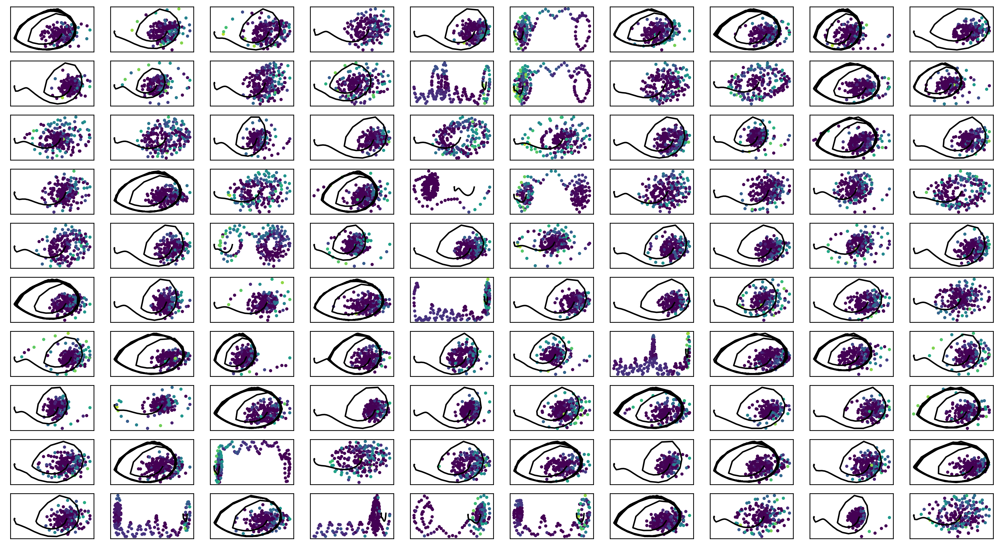

In [36]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter4.png")

In [37]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [38]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [39]:
# i = 35
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train: iter 0  trainloss -18.72744  validloss -122.65286±0.00000  bestvalidloss -122.65286  last_update 0
train: iter 1  trainloss -21.89287  validloss -156.22199±0.00000  bestvalidloss -156.22199  last_update 0
train: iter 2  trainloss -22.83719  validloss -168.30346±0.00000  bestvalidloss -168.30346  last_update 0
train: iter 3  trainloss -22.31382  validloss -154.81505±0.00000  bestvalidloss -168.30346  last_update 1
train: iter 4  trainloss -22.87987  validloss -160.52000±0.00000  bestvalidloss -168.30346  last_update 2
train: iter 5  trainloss -23.32720  validloss -158.92318±0.00000  bestvalidloss -168.30346  last_update 3
train: iter 6  trainloss -23.71948  validloss -159.92401±0.00000  bestvalidloss -168.30346  last_update 4
train: iter 7  trainloss -22.83196  validloss -161.85431±0.00000  bestvalidloss -168.30346  last_update 5
train: iter 8  trainloss -23.50719  validloss -137.79074±0.00000  bestvalidloss -168.30346  last_update 6
train: iter 9  trainloss -23.63862  validloss 

train: iter 77  trainloss -27.83181  validloss -146.11613±0.00000  bestvalidloss -249.17857  last_update 23
train: iter 78  trainloss -25.52930  validloss -206.89019±0.00000  bestvalidloss -249.17857  last_update 24
train: iter 79  trainloss -25.45386  validloss -164.71262±0.00000  bestvalidloss -249.17857  last_update 25
train: iter 80  trainloss -26.15305  validloss -180.91702±0.00000  bestvalidloss -249.17857  last_update 26
train: iter 81  trainloss -24.61096  validloss -196.82660±0.00000  bestvalidloss -249.17857  last_update 27
train: iter 82  trainloss -27.95699  validloss -212.35466±0.00000  bestvalidloss -249.17857  last_update 28
train: iter 83  trainloss -23.55005  validloss -214.73450±0.00000  bestvalidloss -249.17857  last_update 29
train: iter 84  trainloss -26.43331  validloss -211.99992±0.00000  bestvalidloss -249.17857  last_update 30
train: iter 85  trainloss -25.64303  validloss -221.30276±0.00000  bestvalidloss -249.17857  last_update 31
train: iter 86  trainloss -3

train: iter 153  trainloss -27.80380  validloss -232.87037±0.00000  bestvalidloss -249.17857  last_update 99
train: iter 154  trainloss -27.97448  validloss -144.01574±0.00000  bestvalidloss -249.17857  last_update 100
train: fin
train: iter 0  trainloss -26.30848  validloss -242.14770±0.00000  bestvalidloss -242.14770  last_update 0
train: iter 1  trainloss -26.80657  validloss -164.93638±0.00000  bestvalidloss -242.14770  last_update 1
train: iter 2  trainloss -25.39056  validloss -191.79649±0.00000  bestvalidloss -242.14770  last_update 2
train: iter 3  trainloss -24.07603  validloss -164.19618±0.00000  bestvalidloss -242.14770  last_update 3
train: iter 4  trainloss -24.92686  validloss -182.14779±0.00000  bestvalidloss -242.14770  last_update 4
train: iter 5  trainloss -28.57549  validloss -254.49873±0.00000  bestvalidloss -254.49873  last_update 0
train: iter 6  trainloss -24.66144  validloss -154.90371±0.00000  bestvalidloss -254.49873  last_update 1
train: iter 7  trainloss -25

train: iter 74  trainloss -26.55987  validloss -170.96270±0.00000  bestvalidloss -254.49873  last_update 69
train: iter 75  trainloss -25.08030  validloss -208.12078±0.00000  bestvalidloss -254.49873  last_update 70
train: iter 76  trainloss -27.47905  validloss -198.25433±0.00000  bestvalidloss -254.49873  last_update 71
train: iter 77  trainloss -29.33474  validloss -228.09951±0.00000  bestvalidloss -254.49873  last_update 72
train: iter 78  trainloss -25.68646  validloss -146.44410±0.00000  bestvalidloss -254.49873  last_update 73
train: iter 79  trainloss -25.68527  validloss -137.20489±0.00000  bestvalidloss -254.49873  last_update 74
train: iter 80  trainloss -28.26795  validloss -248.14102±0.00000  bestvalidloss -254.49873  last_update 75
train: iter 81  trainloss -29.77905  validloss -175.31815±0.00000  bestvalidloss -254.49873  last_update 76
train: iter 82  trainloss -29.55643  validloss -224.28186±0.00000  bestvalidloss -254.49873  last_update 77
train: iter 83  trainloss -2

train: iter 150  trainloss -25.77548  validloss -210.75434±0.00000  bestvalidloss -265.82392  last_update 52
train: iter 151  trainloss -26.00004  validloss -158.25627±0.00000  bestvalidloss -265.82392  last_update 53
train: iter 152  trainloss -28.57933  validloss -205.64023±0.00000  bestvalidloss -265.82392  last_update 54
train: iter 153  trainloss -28.72518  validloss -197.27908±0.00000  bestvalidloss -265.82392  last_update 55
train: iter 154  trainloss -27.69349  validloss -175.35328±0.00000  bestvalidloss -265.82392  last_update 56
train: iter 155  trainloss -27.16586  validloss -220.56309±0.00000  bestvalidloss -265.82392  last_update 57
train: iter 156  trainloss -28.26311  validloss -226.80902±0.00000  bestvalidloss -265.82392  last_update 58
train: iter 157  trainloss -27.99184  validloss -223.84661±0.00000  bestvalidloss -265.82392  last_update 59
train: iter 158  trainloss -25.78127  validloss -187.01435±0.00000  bestvalidloss -265.82392  last_update 60
train: iter 159  tr

train: iter 27  trainloss -10.82526  validloss -160.73535±0.00000  bestvalidloss -667.18479  last_update 14
train: iter 28  trainloss -13.03365  validloss -184.80550±0.00000  bestvalidloss -667.18479  last_update 15
train: iter 29  trainloss -12.48446  validloss -120.72255±0.00000  bestvalidloss -667.18479  last_update 16
train: iter 30  trainloss -12.91075  validloss -156.24724±0.00000  bestvalidloss -667.18479  last_update 17
train: iter 31  trainloss -12.49773  validloss -150.52138±0.00000  bestvalidloss -667.18479  last_update 18
train: iter 32  trainloss -13.08865  validloss -181.64355±0.00000  bestvalidloss -667.18479  last_update 19
train: iter 33  trainloss -14.61040  validloss -183.55276±0.00000  bestvalidloss -667.18479  last_update 20
train: iter 34  trainloss -19.46275  validloss -176.45977±0.00000  bestvalidloss -667.18479  last_update 21
train: iter 35  trainloss -20.66651  validloss -149.79699±0.00000  bestvalidloss -667.18479  last_update 22
train: iter 36  trainloss -2

train: iter 103  trainloss -40.49470  validloss -119.62483±0.00000  bestvalidloss -667.18479  last_update 90
train: iter 104  trainloss -34.27377  validloss -139.58923±0.00000  bestvalidloss -667.18479  last_update 91
train: iter 105  trainloss -36.60151  validloss -123.57401±0.00000  bestvalidloss -667.18479  last_update 92
train: iter 106  trainloss -39.60829  validloss -125.47472±0.00000  bestvalidloss -667.18479  last_update 93
train: iter 107  trainloss -35.99502  validloss -123.22558±0.00000  bestvalidloss -667.18479  last_update 94
train: iter 108  trainloss -37.82341  validloss -142.24920±0.00000  bestvalidloss -667.18479  last_update 95
train: iter 109  trainloss -42.30123  validloss -202.19772±0.00000  bestvalidloss -667.18479  last_update 96
train: iter 110  trainloss -39.08324  validloss -229.96197±0.00000  bestvalidloss -667.18479  last_update 97
train: iter 111  trainloss -38.07697  validloss -153.02282±0.00000  bestvalidloss -667.18479  last_update 98
train: iter 112  tr

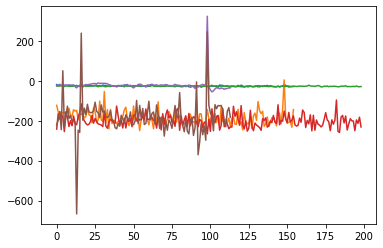

In [40]:
# iwvi.reset_encdec()
# iwvi.load_base()
# iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
# vae_lr=5e-4
# alpha=0.1
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)


print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

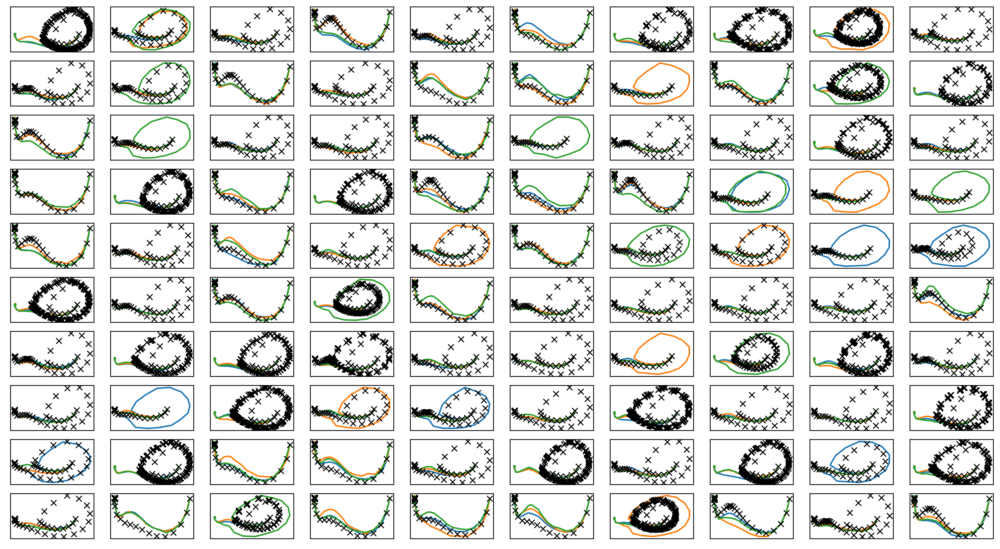

In [41]:
iwvi.get_sim_rollout_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter4.png")
print("実環境方策rollout vs Sim環境方策rollout")

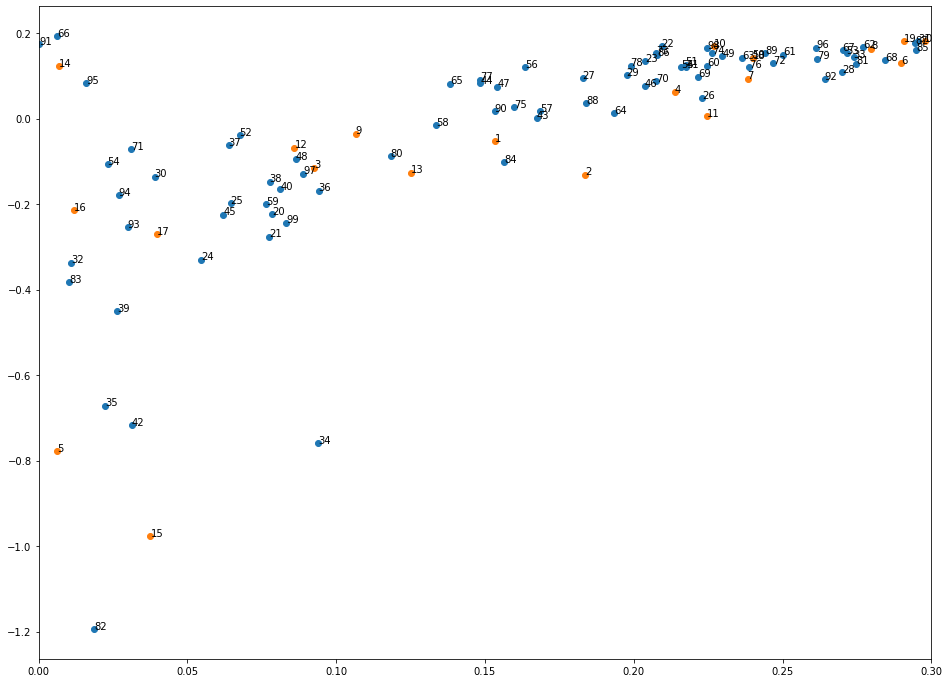

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [42]:
plt.figure(figsize=(16,12))
np_mulogvar = []
for i in range(len(iwvi.mulogvar_list_for_mixture_of_gaussian_belief)):
    np_mulogvar.append(iwvi.mulogvar_list_for_mixture_of_gaussian_belief[i].numpy())
np_mulogvar = np.array(np_mulogvar)

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])

# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

# Iter5

In [43]:
iwvi.get_sim_rollout_data_randomlen()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [44]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.13259  validloss 0.18665±0.00000  bestvalidloss 0.18665  last_update 0
train: iter 1  trainloss 0.09896  validloss 0.15045±0.00000  bestvalidloss 0.15045  last_update 0
train: iter 2  trainloss 0.08688  validloss 0.10551±0.00000  bestvalidloss 0.10551  last_update 0
train: iter 3  trainloss 0.08054  validloss 0.09519±0.00000  bestvalidloss 0.09519  last_update 0
train: iter 4  trainloss 0.07587  validloss 0.08595±0.00000  bestvalidloss 0.08595  last_update 0
train: iter 5  trainloss 0.07280  validloss 0.07569±0.00000  bestvalidloss 0.07569  last_update 0
train: iter 6  trainloss 0.07096  validloss 0.09575±0.00000  bestvalidloss 0.07569  last_update 1
train: iter 7  trainloss 0.06671  validloss 0.07184±0.00000  bestvalidloss 0.07184  last_update 0
train: iter 8  trainloss 0.06555  validloss 0.06452±0.00000  bestvalidloss 0.06452  last_update 0
train: iter 9  trainloss 0.06333  validloss 0.06394±0.00000  bestvalidloss 0.06394  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.04490  validloss 0.05212±0.00000  bestvalidloss 0.04874  last_update 49
train: iter 84  trainloss 0.04615  validloss 0.05092±0.00000  bestvalidloss 0.04874  last_update 50
train: iter 85  trainloss 0.04651  validloss 0.04999±0.00000  bestvalidloss 0.04874  last_update 51
train: iter 86  trainloss 0.04469  validloss 0.04873±0.00000  bestvalidloss 0.04873  last_update 0
train: iter 87  trainloss 0.04342  validloss 0.05067±0.00000  bestvalidloss 0.04873  last_update 1
train: iter 88  trainloss 0.04477  validloss 0.05198±0.00000  bestvalidloss 0.04873  last_update 2
train: iter 89  trainloss 0.04484  validloss 0.04990±0.00000  bestvalidloss 0.04873  last_update 3
train: iter 90  trainloss 0.04301  validloss 0.04958±0.00000  bestvalidloss 0.04873  last_update 4
train: iter 91  trainloss 0.04350  validloss 0.04856±0.00000  bestvalidloss 0.04856  last_update 0
train: iter 92  trainloss 0.04341  validloss 0.04974±0.00000  bestvalidloss 0.04856  last_update 1
train: 

train: iter 165  trainloss 0.03996  validloss 0.05168±0.00000  bestvalidloss 0.04682  last_update 44
train: iter 166  trainloss 0.03949  validloss 0.04848±0.00000  bestvalidloss 0.04682  last_update 45
train: iter 167  trainloss 0.03935  validloss 0.05030±0.00000  bestvalidloss 0.04682  last_update 46
train: iter 168  trainloss 0.03932  validloss 0.05092±0.00000  bestvalidloss 0.04682  last_update 47
train: iter 169  trainloss 0.04122  validloss 0.05124±0.00000  bestvalidloss 0.04682  last_update 48
train: iter 170  trainloss 0.03833  validloss 0.04845±0.00000  bestvalidloss 0.04682  last_update 49
train: iter 171  trainloss 0.04038  validloss 0.04922±0.00000  bestvalidloss 0.04682  last_update 50
train: iter 172  trainloss 0.03956  validloss 0.04815±0.00000  bestvalidloss 0.04682  last_update 51
train: iter 173  trainloss 0.03875  validloss 0.04867±0.00000  bestvalidloss 0.04682  last_update 52
train: iter 174  trainloss 0.03888  validloss 0.04828±0.00000  bestvalidloss 0.04682  last_

1e-08 1000.0


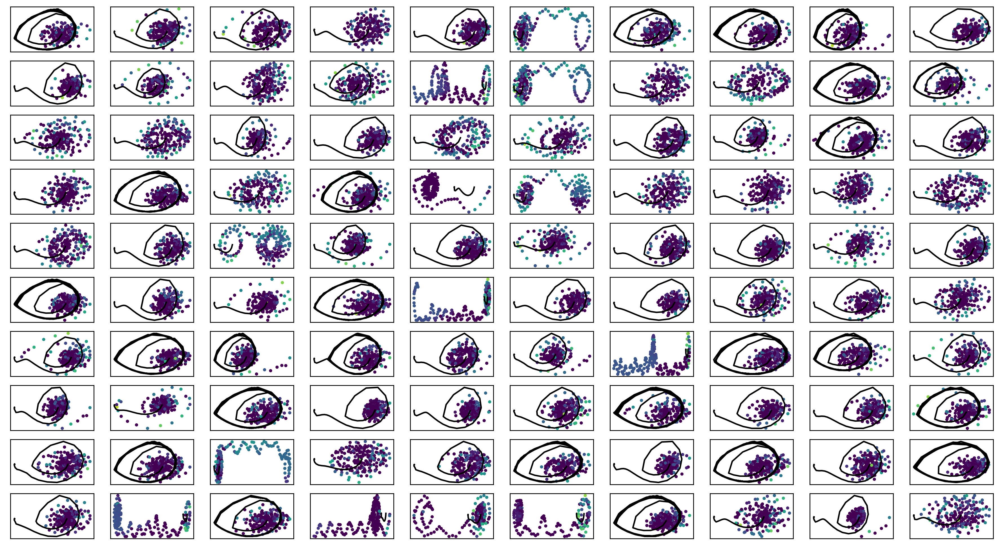

In [45]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter5.png")

In [46]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [47]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train: iter 0  trainloss -13.86873  validloss -81.74542±0.00000  bestvalidloss -81.74542  last_update 0
train: iter 1  trainloss -14.02617  validloss -84.92646±0.00000  bestvalidloss -84.92646  last_update 0
train: iter 2  trainloss -11.48828  validloss 64.75396±0.00000  bestvalidloss -84.92646  last_update 1
train: iter 3  trainloss -13.63189  validloss -89.64384±0.00000  bestvalidloss -89.64384  last_update 0
train: iter 4  trainloss -14.64941  validloss -95.77216±0.00000  bestvalidloss -95.77216  last_update 0
train: iter 5  trainloss -14.87668  validloss -99.01925±0.00000  bestvalidloss -99.01925  last_update 0
train: iter 6  trainloss -13.84021  validloss -82.15329±0.00000  bestvalidloss -99.01925  last_update 1
train: iter 7  trainloss -14.81793  validloss -96.91903±0.00000  bestvalidloss -99.01925  last_update 2
train: iter 8  trainloss -13.17593  validloss -62.23272±0.00000  bestvalidloss -99.01925  last_update 3
train: iter 9  trainloss -15.16357  validloss -99.67098±0.00000  

train: iter 77  trainloss -14.81413  validloss -81.77773±0.00000  bestvalidloss -106.01254  last_update 66
train: iter 78  trainloss -15.28216  validloss -95.85109±0.00000  bestvalidloss -106.01254  last_update 67
train: iter 79  trainloss -14.24092  validloss -92.86833±0.00000  bestvalidloss -106.01254  last_update 68
train: iter 80  trainloss -14.62148  validloss -91.11360±0.00000  bestvalidloss -106.01254  last_update 69
train: iter 81  trainloss -14.59718  validloss -102.06992±0.00000  bestvalidloss -106.01254  last_update 70
train: iter 82  trainloss -13.91972  validloss -38.19213±0.00000  bestvalidloss -106.01254  last_update 71
train: iter 83  trainloss -15.13266  validloss -99.86078±0.00000  bestvalidloss -106.01254  last_update 72
train: iter 84  trainloss -15.19552  validloss -95.25191±0.00000  bestvalidloss -106.01254  last_update 73
train: iter 85  trainloss -14.93254  validloss -58.02397±0.00000  bestvalidloss -106.01254  last_update 74
train: iter 86  trainloss -12.85764 

train: iter 154  trainloss -15.23321  validloss -77.74626±0.00000  bestvalidloss -110.85663  last_update 54
train: iter 155  trainloss -15.66091  validloss -95.36505±0.00000  bestvalidloss -110.85663  last_update 55
train: iter 156  trainloss -15.45687  validloss -75.82509±0.00000  bestvalidloss -110.85663  last_update 56
train: iter 157  trainloss -14.63533  validloss -73.86467±0.00000  bestvalidloss -110.85663  last_update 57
train: iter 158  trainloss -14.28733  validloss -66.44725±0.00000  bestvalidloss -110.85663  last_update 58
train: iter 159  trainloss 0.39035  validloss 14.54109±0.00000  bestvalidloss -110.85663  last_update 59
train: iter 160  trainloss -13.01633  validloss -88.33697±0.00000  bestvalidloss -110.85663  last_update 60
train: iter 161  trainloss -14.43771  validloss -95.63853±0.00000  bestvalidloss -110.85663  last_update 61
train: iter 162  trainloss -15.08265  validloss -90.22876±0.00000  bestvalidloss -110.85663  last_update 62
train: iter 163  trainloss -15.

train: iter 30  trainloss -15.64093  validloss -94.39472±0.00000  bestvalidloss -102.76211  last_update 30
train: iter 31  trainloss -15.87950  validloss -92.12716±0.00000  bestvalidloss -102.76211  last_update 31
train: iter 32  trainloss -13.36319  validloss -63.25050±0.00000  bestvalidloss -102.76211  last_update 32
train: iter 33  trainloss -16.51310  validloss -87.08063±0.00000  bestvalidloss -102.76211  last_update 33
train: iter 34  trainloss -15.77710  validloss -66.63367±0.00000  bestvalidloss -102.76211  last_update 34
train: iter 35  trainloss -14.85755  validloss -56.54747±0.00000  bestvalidloss -102.76211  last_update 35
train: iter 36  trainloss -14.90924  validloss 14.88796±0.00000  bestvalidloss -102.76211  last_update 36
train: iter 37  trainloss -15.10232  validloss -63.36033±0.00000  bestvalidloss -102.76211  last_update 37
train: iter 38  trainloss -15.72129  validloss -66.51714±0.00000  bestvalidloss -102.76211  last_update 38
train: iter 39  trainloss -15.27859  v

train: iter 107  trainloss -16.01297  validloss -55.01679±0.00000  bestvalidloss -113.76262  last_update 5
train: iter 108  trainloss -15.92176  validloss -21.51367±0.00000  bestvalidloss -113.76262  last_update 6
train: iter 109  trainloss -15.47176  validloss -67.63666±0.00000  bestvalidloss -113.76262  last_update 7
train: iter 110  trainloss -14.51313  validloss -62.45460±0.00000  bestvalidloss -113.76262  last_update 8
train: iter 111  trainloss -7.45758  validloss -74.23289±0.00000  bestvalidloss -113.76262  last_update 9
train: iter 112  trainloss -14.56142  validloss -42.96584±0.00000  bestvalidloss -113.76262  last_update 10
train: iter 113  trainloss -14.57749  validloss -82.92814±0.00000  bestvalidloss -113.76262  last_update 11
train: iter 114  trainloss -15.55072  validloss -88.18285±0.00000  bestvalidloss -113.76262  last_update 12
train: iter 115  trainloss -16.28139  validloss -97.60497±0.00000  bestvalidloss -113.76262  last_update 13
train: iter 116  trainloss -16.155

train: iter 183  trainloss -14.94430  validloss -82.28737±0.00000  bestvalidloss -113.76262  last_update 81
train: iter 184  trainloss -15.46316  validloss -75.56180±0.00000  bestvalidloss -113.76262  last_update 82
train: iter 185  trainloss -15.21324  validloss -64.11500±0.00000  bestvalidloss -113.76262  last_update 83
train: iter 186  trainloss -15.84806  validloss -46.49984±0.00000  bestvalidloss -113.76262  last_update 84
train: iter 187  trainloss -15.81333  validloss -103.29567±0.00000  bestvalidloss -113.76262  last_update 85
train: iter 188  trainloss -15.62229  validloss -60.52943±0.00000  bestvalidloss -113.76262  last_update 86
train: iter 189  trainloss -12.81191  validloss -76.25600±0.00000  bestvalidloss -113.76262  last_update 87
train: iter 190  trainloss -14.74715  validloss -70.79576±0.00000  bestvalidloss -113.76262  last_update 88
train: iter 191  trainloss -15.32716  validloss -74.19922±0.00000  bestvalidloss -113.76262  last_update 89
train: iter 192  trainloss 

train: iter 259  trainloss -15.10688  validloss -70.52979±0.00000  bestvalidloss -117.62689  last_update 60
train: iter 260  trainloss -16.08161  validloss -95.70929±0.00000  bestvalidloss -117.62689  last_update 61
train: iter 261  trainloss -15.52667  validloss -77.87268±0.00000  bestvalidloss -117.62689  last_update 62
train: iter 262  trainloss -15.80940  validloss -24.29205±0.00000  bestvalidloss -117.62689  last_update 63
train: iter 263  trainloss -15.71140  validloss -29.38457±0.00000  bestvalidloss -117.62689  last_update 64
train: iter 264  trainloss -15.59868  validloss -78.94474±0.00000  bestvalidloss -117.62689  last_update 65
train: iter 265  trainloss -15.68017  validloss -83.95501±0.00000  bestvalidloss -117.62689  last_update 66
train: iter 266  trainloss -15.31226  validloss -64.32735±0.00000  bestvalidloss -117.62689  last_update 67
train: iter 267  trainloss -15.09222  validloss -51.96578±0.00000  bestvalidloss -117.62689  last_update 68
train: iter 268  trainloss -

train: iter 36  trainloss -28.87937  validloss -115.50616±0.00000  bestvalidloss -175.30247  last_update 1
train: iter 37  trainloss -26.95955  validloss -105.29448±0.00000  bestvalidloss -175.30247  last_update 2
train: iter 38  trainloss -28.32279  validloss -122.19668±0.00000  bestvalidloss -175.30247  last_update 3
train: iter 39  trainloss -28.16931  validloss -137.79452±0.00000  bestvalidloss -175.30247  last_update 4
train: iter 40  trainloss -20.74509  validloss -49.27569±0.00000  bestvalidloss -175.30247  last_update 5
train: iter 41  trainloss -25.50183  validloss -103.51225±0.00000  bestvalidloss -175.30247  last_update 6
train: iter 42  trainloss 85.67550  validloss -75.07714±0.00000  bestvalidloss -175.30247  last_update 7
train: iter 43  trainloss -13.71565  validloss -60.45123±0.00000  bestvalidloss -175.30247  last_update 8
train: iter 44  trainloss -17.06416  validloss -118.16349±0.00000  bestvalidloss -175.30247  last_update 9
train: iter 45  trainloss -16.00499  vali

train: iter 113  trainloss -8.69258  validloss 62.22468±0.00000  bestvalidloss -228.20904  last_update 19
train: iter 114  trainloss -15.76061  validloss 17.33093±0.00000  bestvalidloss -228.20904  last_update 20
train: iter 115  trainloss -20.17410  validloss -46.54751±0.00000  bestvalidloss -228.20904  last_update 21
train: iter 116  trainloss -16.33520  validloss -19.79029±0.00000  bestvalidloss -228.20904  last_update 22
train: iter 117  trainloss -16.13704  validloss -75.59371±0.00000  bestvalidloss -228.20904  last_update 23
train: iter 118  trainloss -17.15864  validloss -59.21843±0.00000  bestvalidloss -228.20904  last_update 24
train: iter 119  trainloss -20.86430  validloss -65.94903±0.00000  bestvalidloss -228.20904  last_update 25
train: iter 120  trainloss -20.16411  validloss -70.73226±0.00000  bestvalidloss -228.20904  last_update 26
train: iter 121  trainloss -19.24121  validloss -56.83133±0.00000  bestvalidloss -228.20904  last_update 27
train: iter 122  trainloss -19.

train: iter 189  trainloss -16.93831  validloss -59.80441±0.00000  bestvalidloss -473.02628  last_update 18
train: iter 190  trainloss -17.00177  validloss -74.07465±0.00000  bestvalidloss -473.02628  last_update 19
train: iter 191  trainloss -16.68213  validloss -63.91656±0.00000  bestvalidloss -473.02628  last_update 20
train: iter 192  trainloss -14.65124  validloss -30.27797±0.00000  bestvalidloss -473.02628  last_update 21
train: iter 193  trainloss -15.67571  validloss -59.53839±0.00000  bestvalidloss -473.02628  last_update 22
train: iter 194  trainloss -13.70659  validloss -8.92259±0.00000  bestvalidloss -473.02628  last_update 23
train: iter 195  trainloss -16.94362  validloss -95.54947±0.00000  bestvalidloss -473.02628  last_update 24
train: iter 196  trainloss -25.33192  validloss -170.80978±0.00000  bestvalidloss -473.02628  last_update 25
train: iter 197  trainloss -23.29318  validloss -121.05551±0.00000  bestvalidloss -473.02628  last_update 26
train: iter 198  trainloss 

train: iter 265  trainloss -49.56579  validloss -221.78695±0.00000  bestvalidloss -529.63931  last_update 30
train: iter 266  trainloss -23.65246  validloss -143.30890±0.00000  bestvalidloss -529.63931  last_update 31
train: iter 267  trainloss -2.90125  validloss -420.11747±0.00000  bestvalidloss -529.63931  last_update 32
train: iter 268  trainloss -20.21514  validloss -86.84167±0.00000  bestvalidloss -529.63931  last_update 33
train: iter 269  trainloss -18.30133  validloss -99.85487±0.00000  bestvalidloss -529.63931  last_update 34
train: iter 270  trainloss -20.60891  validloss -79.71329±0.00000  bestvalidloss -529.63931  last_update 35
train: iter 271  trainloss -22.56017  validloss -120.89718±0.00000  bestvalidloss -529.63931  last_update 36
train: iter 272  trainloss -23.65820  validloss -84.41867±0.00000  bestvalidloss -529.63931  last_update 37
train: iter 273  trainloss -21.03048  validloss -127.07355±0.00000  bestvalidloss -529.63931  last_update 38
train: iter 274  trainlo

train: iter 341  trainloss -20.72335  validloss -34.45422±0.00000  bestvalidloss -808.73291  last_update 11
train: iter 342  trainloss -22.72537  validloss -42.48097±0.00000  bestvalidloss -808.73291  last_update 12
train: iter 343  trainloss -25.16642  validloss -24.54501±0.00000  bestvalidloss -808.73291  last_update 13
train: iter 344  trainloss -26.20168  validloss -47.90970±0.00000  bestvalidloss -808.73291  last_update 14
train: iter 345  trainloss -36.64733  validloss -66.93614±0.00000  bestvalidloss -808.73291  last_update 15
train: iter 346  trainloss -42.05770  validloss -343.29266±0.00000  bestvalidloss -808.73291  last_update 16
train: iter 347  trainloss -16.49889  validloss -16.37349±0.00000  bestvalidloss -808.73291  last_update 17
train: iter 348  trainloss -19.31026  validloss -9.70544±0.00000  bestvalidloss -808.73291  last_update 18
train: iter 349  trainloss -22.51142  validloss -91.69594±0.00000  bestvalidloss -808.73291  last_update 19
train: iter 350  trainloss -

train: iter 417  trainloss -36.77534  validloss -156.80299±0.00000  bestvalidloss -1464.72280  last_update 58
train: iter 418  trainloss -100.68698  validloss -16.31311±0.00000  bestvalidloss -1464.72280  last_update 59
train: iter 419  trainloss -119.81200  validloss -552.84284±0.00000  bestvalidloss -1464.72280  last_update 60
train: iter 420  trainloss -26.39180  validloss -35.73610±0.00000  bestvalidloss -1464.72280  last_update 61
train: iter 421  trainloss -33.36262  validloss -35.98702±0.00000  bestvalidloss -1464.72280  last_update 62
train: iter 422  trainloss -38.95001  validloss -29.95342±0.00000  bestvalidloss -1464.72280  last_update 63
train: iter 423  trainloss -36.63911  validloss -33.58322±0.00000  bestvalidloss -1464.72280  last_update 64
train: iter 424  trainloss -22.33522  validloss -25.95769±0.00000  bestvalidloss -1464.72280  last_update 65
train: iter 425  trainloss -9.52796  validloss 1.86455±0.00000  bestvalidloss -1464.72280  last_update 66
train: iter 426  t

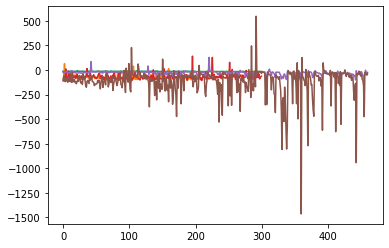

In [48]:
# iwvi.reset_encdec()
# iwvi.load_base()
# iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
# vae_lr=5e-4
# alpha=0.1
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)


print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

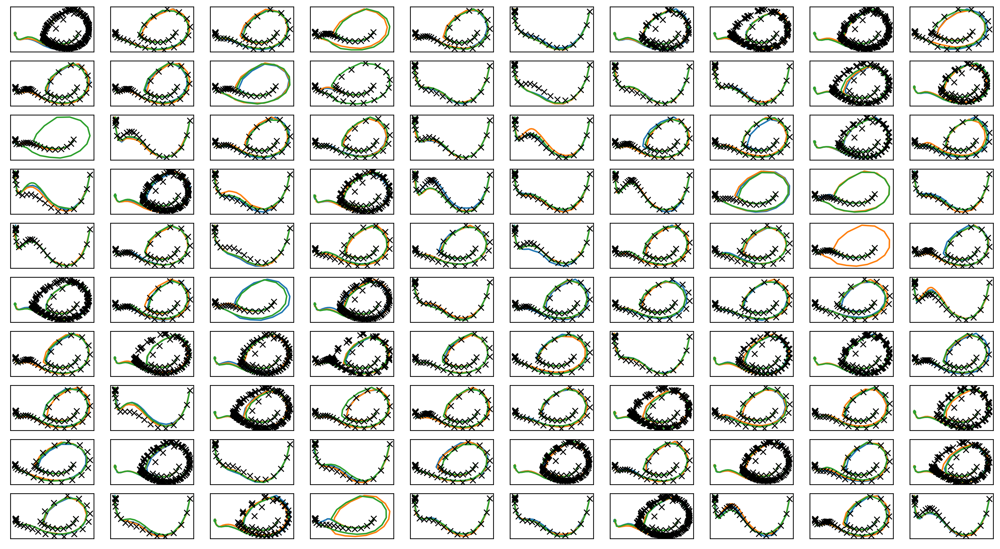

In [49]:
iwvi.get_sim_rollout_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter5.png")
print("実環境方策rollout vs Sim環境方策rollout")

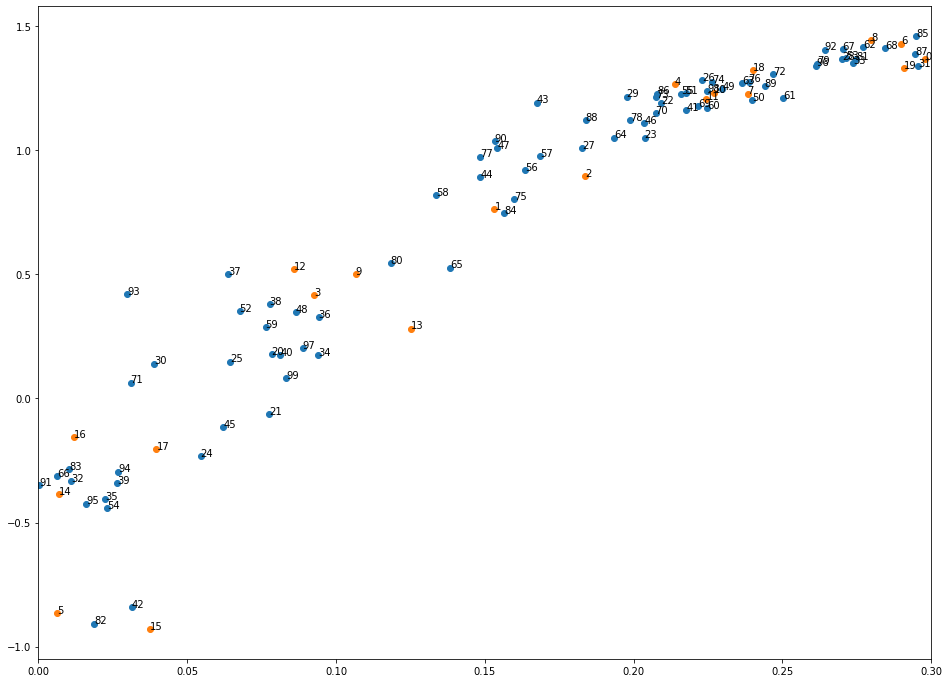

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [50]:
plt.figure(figsize=(16,12))
np_mulogvar = []
for i in range(len(iwvi.mulogvar_list_for_mixture_of_gaussian_belief)):
    np_mulogvar.append(iwvi.mulogvar_list_for_mixture_of_gaussian_belief[i].numpy())
np_mulogvar = np.array(np_mulogvar)

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

# Iter 6 

In [51]:
iwvi.get_sim_rollout_data_randomlen()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [52]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.43269  validloss 1.09468±0.00000  bestvalidloss 1.09468  last_update 0
train: iter 1  trainloss 0.22028  validloss 0.22082±0.00000  bestvalidloss 0.22082  last_update 0
train: iter 2  trainloss 0.18128  validloss 0.16728±0.00000  bestvalidloss 0.16728  last_update 0
train: iter 3  trainloss 0.16333  validloss 0.15225±0.00000  bestvalidloss 0.15225  last_update 0
train: iter 4  trainloss 0.15513  validloss 0.13425±0.00000  bestvalidloss 0.13425  last_update 0
train: iter 5  trainloss 0.13767  validloss 0.13184±0.00000  bestvalidloss 0.13184  last_update 0
train: iter 6  trainloss 0.12912  validloss 0.14210±0.00000  bestvalidloss 0.13184  last_update 1
train: iter 7  trainloss 0.12540  validloss 0.12856±0.00000  bestvalidloss 0.12856  last_update 0
train: iter 8  trainloss 0.11835  validloss 0.12118±0.00000  bestvalidloss 0.12118  last_update 0
train: iter 9  trainloss 0.11193  validloss 0.12088±0.00000  bestvalidloss 0.12088  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.06386  validloss 0.08387±0.00000  bestvalidloss 0.08103  last_update 12
train: iter 84  trainloss 0.06223  validloss 0.08217±0.00000  bestvalidloss 0.08103  last_update 13
train: iter 85  trainloss 0.06228  validloss 0.08456±0.00000  bestvalidloss 0.08103  last_update 14
train: iter 86  trainloss 0.06589  validloss 0.08238±0.00000  bestvalidloss 0.08103  last_update 15
train: iter 87  trainloss 0.06241  validloss 0.08334±0.00000  bestvalidloss 0.08103  last_update 16
train: iter 88  trainloss 0.06032  validloss 0.08045±0.00000  bestvalidloss 0.08045  last_update 0
train: iter 89  trainloss 0.06113  validloss 0.08147±0.00000  bestvalidloss 0.08045  last_update 1
train: iter 90  trainloss 0.06411  validloss 0.08251±0.00000  bestvalidloss 0.08045  last_update 2
train: iter 91  trainloss 0.06049  validloss 0.08328±0.00000  bestvalidloss 0.08045  last_update 3
train: iter 92  trainloss 0.05967  validloss 0.08071±0.00000  bestvalidloss 0.08045  last_update 4
train

train: iter 165  trainloss 0.05592  validloss 0.07883±0.00000  bestvalidloss 0.07531  last_update 7
train: iter 166  trainloss 0.05972  validloss 0.07974±0.00000  bestvalidloss 0.07531  last_update 8
train: iter 167  trainloss 0.05618  validloss 0.07771±0.00000  bestvalidloss 0.07531  last_update 9
train: iter 168  trainloss 0.05556  validloss 0.07793±0.00000  bestvalidloss 0.07531  last_update 10
train: iter 169  trainloss 0.05588  validloss 0.07785±0.00000  bestvalidloss 0.07531  last_update 11
train: iter 170  trainloss 0.05664  validloss 0.07670±0.00000  bestvalidloss 0.07531  last_update 12
train: iter 171  trainloss 0.05628  validloss 0.07807±0.00000  bestvalidloss 0.07531  last_update 13
train: iter 172  trainloss 0.05764  validloss 0.07575±0.00000  bestvalidloss 0.07531  last_update 14
train: iter 173  trainloss 0.05569  validloss 0.08115±0.00000  bestvalidloss 0.07531  last_update 15
train: iter 174  trainloss 0.05498  validloss 0.07565±0.00000  bestvalidloss 0.07531  last_upd

train: iter 247  trainloss 0.05335  validloss 0.07554±0.00000  bestvalidloss 0.07277  last_update 23
train: iter 248  trainloss 0.05561  validloss 0.07534±0.00000  bestvalidloss 0.07277  last_update 24
train: iter 249  trainloss 0.06709  validloss 0.07606±0.00000  bestvalidloss 0.07277  last_update 25
train: iter 250  trainloss 0.05345  validloss 0.07834±0.00000  bestvalidloss 0.07277  last_update 26
train: iter 251  trainloss 0.05266  validloss 0.07346±0.00000  bestvalidloss 0.07277  last_update 27
train: iter 252  trainloss 0.05342  validloss 0.07594±0.00000  bestvalidloss 0.07277  last_update 28
train: iter 253  trainloss 0.05225  validloss 0.07487±0.00000  bestvalidloss 0.07277  last_update 29
train: iter 254  trainloss 0.05319  validloss 0.07492±0.00000  bestvalidloss 0.07277  last_update 30
train: iter 255  trainloss 0.05309  validloss 0.07477±0.00000  bestvalidloss 0.07277  last_update 31
train: iter 256  trainloss 0.05630  validloss 0.07579±0.00000  bestvalidloss 0.07277  last_

train: iter 329  trainloss 0.05794  validloss 0.07376±0.00000  bestvalidloss 0.07137  last_update 30
train: iter 330  trainloss 0.05174  validloss 0.07816±0.00000  bestvalidloss 0.07137  last_update 31
train: iter 331  trainloss 0.05029  validloss 0.07808±0.00000  bestvalidloss 0.07137  last_update 32
train: iter 332  trainloss 0.05397  validloss 0.07622±0.00000  bestvalidloss 0.07137  last_update 33
train: iter 333  trainloss 0.05201  validloss 0.07583±0.00000  bestvalidloss 0.07137  last_update 34
train: iter 334  trainloss 0.05161  validloss 0.07551±0.00000  bestvalidloss 0.07137  last_update 35
train: iter 335  trainloss 0.05223  validloss 0.07510±0.00000  bestvalidloss 0.07137  last_update 36
train: iter 336  trainloss 0.05284  validloss 0.07778±0.00000  bestvalidloss 0.07137  last_update 37
train: iter 337  trainloss 0.05031  validloss 0.07566±0.00000  bestvalidloss 0.07137  last_update 38
train: iter 338  trainloss 0.05423  validloss 0.07344±0.00000  bestvalidloss 0.07137  last_

1e-08 1000.0


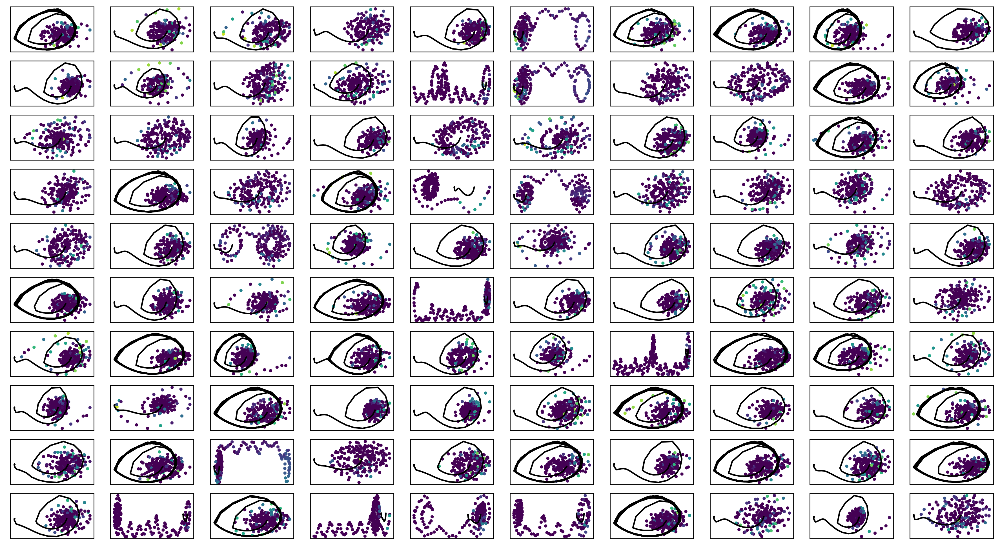

In [53]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter6.png")

In [54]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [55]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train: iter 0  trainloss -26.77206  validloss -192.34650±0.00000  bestvalidloss -192.34650  last_update 0
train: iter 1  trainloss -29.46451  validloss -192.38741±0.00000  bestvalidloss -192.38741  last_update 0
train: iter 2  trainloss -31.81999  validloss -220.32993±0.00000  bestvalidloss -220.32993  last_update 0
train: iter 3  trainloss -31.76557  validloss -239.52103±0.00000  bestvalidloss -239.52103  last_update 0
train: iter 4  trainloss -29.69153  validloss -243.23494±0.00000  bestvalidloss -243.23494  last_update 0
train: iter 5  trainloss -29.91287  validloss -204.77888±0.00000  bestvalidloss -243.23494  last_update 1
train: iter 6  trainloss -30.04725  validloss -252.08911±0.00000  bestvalidloss -252.08911  last_update 0
train: iter 7  trainloss -31.14256  validloss -272.83499±0.00000  bestvalidloss -272.83499  last_update 0
train: iter 8  trainloss -32.64022  validloss -276.13974±0.00000  bestvalidloss -276.13974  last_update 0
train: iter 9  trainloss -32.16905  validloss 

train: iter 77  trainloss -32.81022  validloss -266.51320±0.00000  bestvalidloss -319.28679  last_update 26
train: iter 78  trainloss -35.51866  validloss -278.84010±0.00000  bestvalidloss -319.28679  last_update 27
train: iter 79  trainloss -33.54688  validloss -311.82594±0.00000  bestvalidloss -319.28679  last_update 28
train: iter 80  trainloss -31.20137  validloss -219.96897±0.00000  bestvalidloss -319.28679  last_update 29
train: iter 81  trainloss -35.03988  validloss -334.67365±0.00000  bestvalidloss -334.67365  last_update 0
train: iter 82  trainloss -32.92954  validloss -225.50282±0.00000  bestvalidloss -334.67365  last_update 1
train: iter 83  trainloss -35.10537  validloss -234.73971±0.00000  bestvalidloss -334.67365  last_update 2
train: iter 84  trainloss -32.94968  validloss -287.96616±0.00000  bestvalidloss -334.67365  last_update 3
train: iter 85  trainloss -35.18688  validloss -227.29283±0.00000  bestvalidloss -334.67365  last_update 4
train: iter 86  trainloss -35.614

train: iter 153  trainloss -33.27579  validloss -294.31666±0.00000  bestvalidloss -334.67365  last_update 72
train: iter 154  trainloss -32.84915  validloss -287.25635±0.00000  bestvalidloss -334.67365  last_update 73
train: iter 155  trainloss -35.23006  validloss -218.47328±0.00000  bestvalidloss -334.67365  last_update 74
train: iter 156  trainloss -28.73159  validloss -145.96075±0.00000  bestvalidloss -334.67365  last_update 75
train: iter 157  trainloss -34.34775  validloss -226.62938±0.00000  bestvalidloss -334.67365  last_update 76
train: iter 158  trainloss -29.90955  validloss -230.72758±0.00000  bestvalidloss -334.67365  last_update 77
train: iter 159  trainloss -35.06263  validloss -252.66930±0.00000  bestvalidloss -334.67365  last_update 78
train: iter 160  trainloss -31.57135  validloss -255.39579±0.00000  bestvalidloss -334.67365  last_update 79
train: iter 161  trainloss -35.98504  validloss -240.13930±0.00000  bestvalidloss -334.67365  last_update 80
train: iter 162  tr

train: iter 47  trainloss -32.98825  validloss -259.27805±0.00000  bestvalidloss -344.35110  last_update 47
train: iter 48  trainloss -34.98359  validloss -231.91143±0.00000  bestvalidloss -344.35110  last_update 48
train: iter 49  trainloss -36.19116  validloss -233.56919±0.00000  bestvalidloss -344.35110  last_update 49
train: iter 50  trainloss -32.63330  validloss -239.39713±0.00000  bestvalidloss -344.35110  last_update 50
train: iter 51  trainloss -35.61495  validloss -174.65705±0.00000  bestvalidloss -344.35110  last_update 51
train: iter 52  trainloss -32.88946  validloss -308.27728±0.00000  bestvalidloss -344.35110  last_update 52
train: iter 53  trainloss -29.06015  validloss -204.78860±0.00000  bestvalidloss -344.35110  last_update 53
train: iter 54  trainloss -33.19372  validloss -210.78166±0.00000  bestvalidloss -344.35110  last_update 54
train: iter 55  trainloss -30.52809  validloss -265.20645±0.00000  bestvalidloss -344.35110  last_update 55
train: iter 56  trainloss -3

train: iter 22  trainloss -19.90388  validloss -14.76665±0.00000  bestvalidloss -338.11332  last_update 22
train: iter 23  trainloss -26.57622  validloss -191.15857±0.00000  bestvalidloss -338.11332  last_update 23
train: iter 24  trainloss -28.63511  validloss -202.92630±0.00000  bestvalidloss -338.11332  last_update 24
train: iter 25  trainloss -31.44214  validloss -187.61498±0.00000  bestvalidloss -338.11332  last_update 25
train: iter 26  trainloss -9.97065  validloss -169.90789±0.00000  bestvalidloss -338.11332  last_update 26
train: iter 27  trainloss -22.60386  validloss -40.67863±0.00000  bestvalidloss -338.11332  last_update 27
train: iter 28  trainloss -25.43292  validloss -138.36319±0.00000  bestvalidloss -338.11332  last_update 28
train: iter 29  trainloss -26.34058  validloss -189.54457±0.00000  bestvalidloss -338.11332  last_update 29
train: iter 30  trainloss -30.02877  validloss -204.85608±0.00000  bestvalidloss -338.11332  last_update 30
train: iter 31  trainloss -31.2

train: iter 98  trainloss -30.34117  validloss -192.73212±0.00000  bestvalidloss -338.11332  last_update 98
train: iter 99  trainloss -27.72519  validloss -215.44647±0.00000  bestvalidloss -338.11332  last_update 99
train: iter 100  trainloss -30.33038  validloss -155.75168±0.00000  bestvalidloss -338.11332  last_update 100
train: fin
alpha 0.5 vae_lr 0.0005


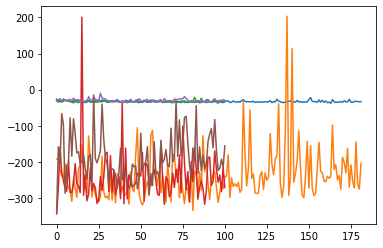

In [56]:
# iwvi.reset_encdec()
# iwvi.load_base()
# iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
# vae_lr=5e-4
# alpha=0.1
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)


print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

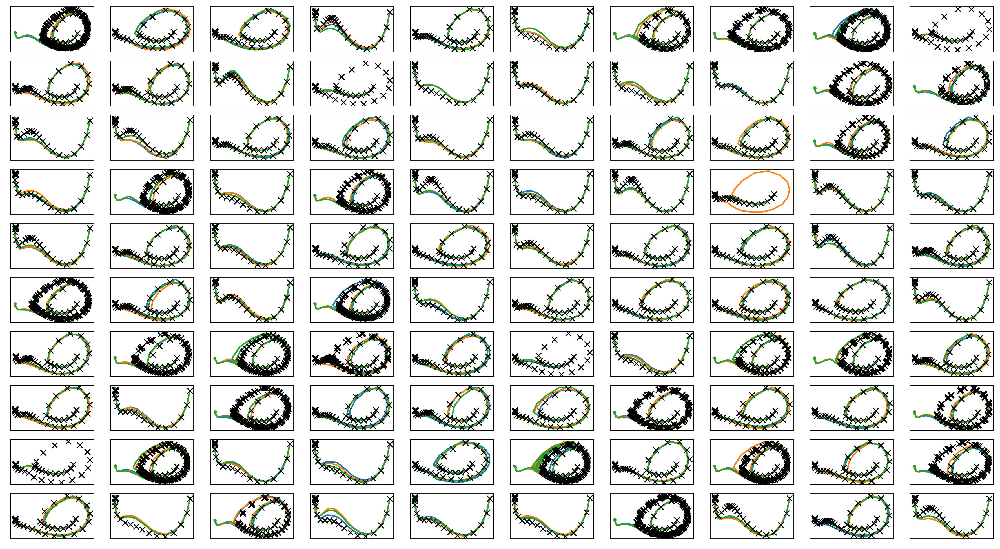

In [57]:
iwvi.get_sim_rollout_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter6.png")
print("実環境方策rollout vs Sim環境方策rollout")

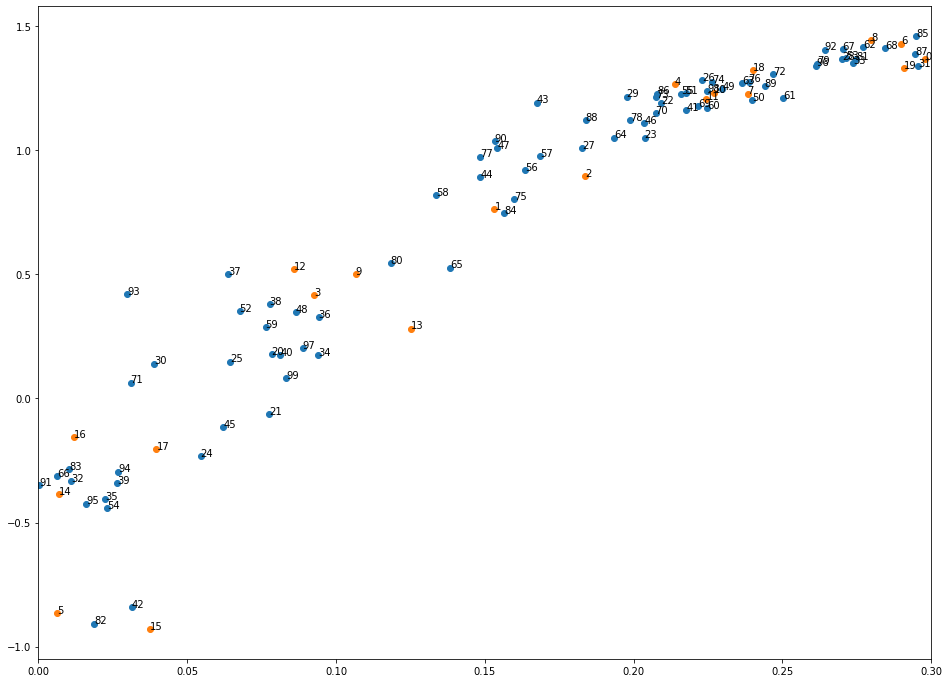

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [58]:
plt.figure(figsize=(16,12))
np_mulogvar = []
for i in range(len(iwvi.mulogvar_list_for_mixture_of_gaussian_belief)):
    np_mulogvar.append(iwvi.mulogvar_list_for_mixture_of_gaussian_belief[i].numpy())
np_mulogvar = np.array(np_mulogvar)

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

# iter7

In [59]:
iwvi.get_sim_rollout_data_randomlen()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [60]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)

train: iter 0  trainloss 0.06687  validloss 0.09733±0.00000  bestvalidloss 0.09733  last_update 0
train: iter 1  trainloss 0.06023  validloss 0.08617±0.00000  bestvalidloss 0.08617  last_update 0
train: iter 2  trainloss 0.05826  validloss 0.08283±0.00000  bestvalidloss 0.08283  last_update 0
train: iter 3  trainloss 0.05629  validloss 0.08177±0.00000  bestvalidloss 0.08177  last_update 0
train: iter 4  trainloss 0.05753  validloss 0.08115±0.00000  bestvalidloss 0.08115  last_update 0
train: iter 5  trainloss 0.05474  validloss 0.08068±0.00000  bestvalidloss 0.08068  last_update 0
train: iter 6  trainloss 0.05549  validloss 0.08337±0.00000  bestvalidloss 0.08068  last_update 1
train: iter 7  trainloss 0.05505  validloss 0.08427±0.00000  bestvalidloss 0.08068  last_update 2
train: iter 8  trainloss 0.05247  validloss 0.08451±0.00000  bestvalidloss 0.08068  last_update 3
train: iter 9  trainloss 0.05474  validloss 0.08212±0.00000  bestvalidloss 0.08068  last_update 4
train: iter 10  trai

train: iter 83  trainloss 0.04637  validloss 0.07732±0.00000  bestvalidloss 0.07623  last_update 6
train: iter 84  trainloss 0.04835  validloss 0.09300±0.00000  bestvalidloss 0.07623  last_update 7
train: iter 85  trainloss 0.04839  validloss 0.08048±0.00000  bestvalidloss 0.07623  last_update 8
train: iter 86  trainloss 0.04630  validloss 0.07641±0.00000  bestvalidloss 0.07623  last_update 9
train: iter 87  trainloss 0.04631  validloss 0.07798±0.00000  bestvalidloss 0.07623  last_update 10
train: iter 88  trainloss 0.04704  validloss 0.07860±0.00000  bestvalidloss 0.07623  last_update 11
train: iter 89  trainloss 0.04658  validloss 0.08174±0.00000  bestvalidloss 0.07623  last_update 12
train: iter 90  trainloss 0.04667  validloss 0.07951±0.00000  bestvalidloss 0.07623  last_update 13
train: iter 91  trainloss 0.04592  validloss 0.07885±0.00000  bestvalidloss 0.07623  last_update 14
train: iter 92  trainloss 0.04939  validloss 0.07972±0.00000  bestvalidloss 0.07623  last_update 15
trai

train: iter 165  trainloss 0.04582  validloss 0.08001±0.00000  bestvalidloss 0.07545  last_update 72
train: iter 166  trainloss 0.04518  validloss 0.08121±0.00000  bestvalidloss 0.07545  last_update 73
train: iter 167  trainloss 0.04480  validloss 0.08386±0.00000  bestvalidloss 0.07545  last_update 74
train: iter 168  trainloss 0.04489  validloss 0.08502±0.00000  bestvalidloss 0.07545  last_update 75
train: iter 169  trainloss 0.04426  validloss 0.08035±0.00000  bestvalidloss 0.07545  last_update 76
train: iter 170  trainloss 0.04462  validloss 0.07510±0.00000  bestvalidloss 0.07510  last_update 0
train: iter 171  trainloss 0.04658  validloss 0.07853±0.00000  bestvalidloss 0.07510  last_update 1
train: iter 172  trainloss 0.04563  validloss 0.07782±0.00000  bestvalidloss 0.07510  last_update 2
train: iter 173  trainloss 0.04672  validloss 0.08374±0.00000  bestvalidloss 0.07510  last_update 3
train: iter 174  trainloss 0.04444  validloss 0.07895±0.00000  bestvalidloss 0.07510  last_upda

train: iter 247  trainloss 0.04355  validloss 0.07868±0.00000  bestvalidloss 0.07510  last_update 77
train: iter 248  trainloss 0.04250  validloss 0.07999±0.00000  bestvalidloss 0.07510  last_update 78
train: iter 249  trainloss 0.04289  validloss 0.08147±0.00000  bestvalidloss 0.07510  last_update 79
train: iter 250  trainloss 0.04453  validloss 0.08258±0.00000  bestvalidloss 0.07510  last_update 80
train: iter 251  trainloss 0.04330  validloss 0.08426±0.00000  bestvalidloss 0.07510  last_update 81
train: iter 252  trainloss 0.04382  validloss 0.08016±0.00000  bestvalidloss 0.07510  last_update 82
train: iter 253  trainloss 0.04372  validloss 0.08231±0.00000  bestvalidloss 0.07510  last_update 83
train: iter 254  trainloss 0.04491  validloss 0.07646±0.00000  bestvalidloss 0.07510  last_update 84
train: iter 255  trainloss 0.04368  validloss 0.08683±0.00000  bestvalidloss 0.07510  last_update 85
train: iter 256  trainloss 0.04362  validloss 0.08403±0.00000  bestvalidloss 0.07510  last_

1e-08 1000.0


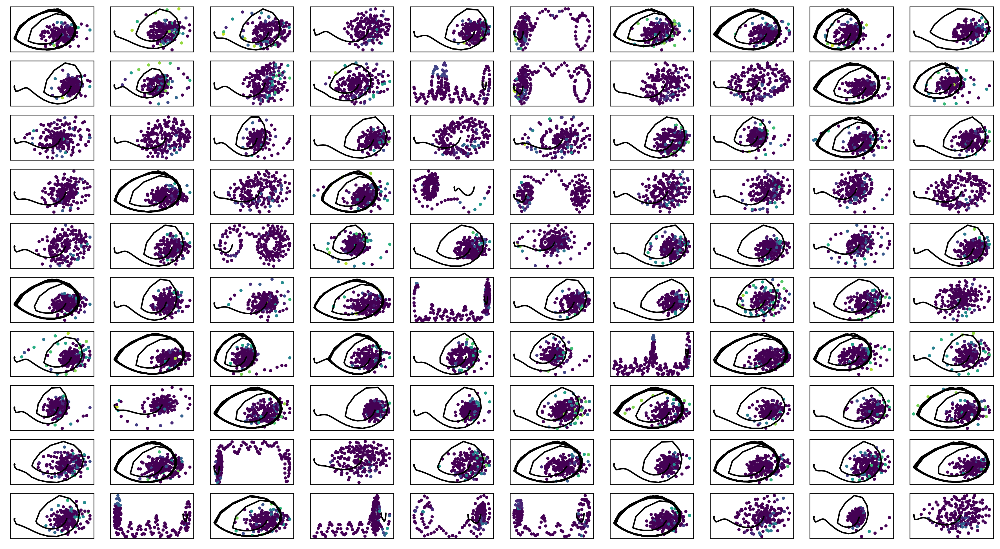

In [61]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter7.png")

train: iter 0  trainloss -23.27673  validloss -303.76925±0.00000  bestvalidloss -303.76925  last_update 0
train: iter 1  trainloss -24.79431  validloss -294.54404±0.00000  bestvalidloss -303.76925  last_update 1
train: iter 2  trainloss -23.42263  validloss -124.21463±0.00000  bestvalidloss -303.76925  last_update 2
train: iter 3  trainloss -25.96577  validloss -189.73661±0.00000  bestvalidloss -303.76925  last_update 3
train: iter 4  trainloss -23.27458  validloss -262.75831±0.00000  bestvalidloss -303.76925  last_update 4
train: iter 5  trainloss -15.78513  validloss -186.36167±0.00000  bestvalidloss -303.76925  last_update 5
train: iter 6  trainloss -25.10919  validloss -240.46888±0.00000  bestvalidloss -303.76925  last_update 6
train: iter 7  trainloss -27.59442  validloss -273.04036±0.00000  bestvalidloss -303.76925  last_update 7
train: iter 8  trainloss -22.80886  validloss -275.88468±0.00000  bestvalidloss -303.76925  last_update 8
train: iter 9  trainloss -26.34272  validloss 

train: iter 77  trainloss -27.20854  validloss -264.77504±0.00000  bestvalidloss -308.28657  last_update 43
train: iter 78  trainloss -17.09113  validloss -152.55305±0.00000  bestvalidloss -308.28657  last_update 44
train: iter 79  trainloss -23.45396  validloss 215.31221±0.00000  bestvalidloss -308.28657  last_update 45
train: iter 80  trainloss -24.13573  validloss -228.02338±0.00000  bestvalidloss -308.28657  last_update 46
train: iter 81  trainloss -26.97819  validloss -226.63698±0.00000  bestvalidloss -308.28657  last_update 47
train: iter 82  trainloss -26.33047  validloss -269.61207±0.00000  bestvalidloss -308.28657  last_update 48
train: iter 83  trainloss -25.90899  validloss -283.28754±0.00000  bestvalidloss -308.28657  last_update 49
train: iter 84  trainloss -22.68727  validloss -153.28282±0.00000  bestvalidloss -308.28657  last_update 50
train: iter 85  trainloss -26.49280  validloss -169.12476±0.00000  bestvalidloss -308.28657  last_update 51
train: iter 86  trainloss -23

train: iter 18  trainloss -26.40300  validloss -265.46565±0.00000  bestvalidloss -295.62299  last_update 18
train: iter 19  trainloss -24.57521  validloss -268.81620±0.00000  bestvalidloss -295.62299  last_update 19
train: iter 20  trainloss -26.35828  validloss -241.45588±0.00000  bestvalidloss -295.62299  last_update 20
train: iter 21  trainloss -23.19653  validloss -169.71675±0.00000  bestvalidloss -295.62299  last_update 21
train: iter 22  trainloss -20.20699  validloss -264.91407±0.00000  bestvalidloss -295.62299  last_update 22
train: iter 23  trainloss -22.17307  validloss -99.68518±0.00000  bestvalidloss -295.62299  last_update 23
train: iter 24  trainloss -24.71847  validloss -214.71523±0.00000  bestvalidloss -295.62299  last_update 24
train: iter 25  trainloss -24.97011  validloss -276.51366±0.00000  bestvalidloss -295.62299  last_update 25
train: iter 26  trainloss -23.88526  validloss 79.60109±0.00000  bestvalidloss -295.62299  last_update 26
train: iter 27  trainloss -19.4

train: iter 95  trainloss -25.48116  validloss -225.82262±0.00000  bestvalidloss -301.73377  last_update 41
train: iter 96  trainloss -21.00500  validloss -214.58543±0.00000  bestvalidloss -301.73377  last_update 42
train: iter 97  trainloss -24.94536  validloss -163.07474±0.00000  bestvalidloss -301.73377  last_update 43
train: iter 98  trainloss -26.30631  validloss -169.50724±0.00000  bestvalidloss -301.73377  last_update 44
train: iter 99  trainloss -23.60082  validloss -264.03320±0.00000  bestvalidloss -301.73377  last_update 45
train: iter 100  trainloss -24.73734  validloss -168.36891±0.00000  bestvalidloss -301.73377  last_update 46
train: iter 101  trainloss -22.82967  validloss -219.40767±0.00000  bestvalidloss -301.73377  last_update 47
train: iter 102  trainloss -19.05234  validloss 78.51925±0.00000  bestvalidloss -301.73377  last_update 48
train: iter 103  trainloss -23.59324  validloss 355.17616±0.00000  bestvalidloss -301.73377  last_update 49
train: iter 104  trainloss 

train: iter 16  trainloss -16.82045  validloss -176.57783±0.00000  bestvalidloss -306.76303  last_update 16
train: iter 17  trainloss -20.12542  validloss -163.86892±0.00000  bestvalidloss -306.76303  last_update 17
train: iter 18  trainloss -21.06055  validloss -166.13865±0.00000  bestvalidloss -306.76303  last_update 18
train: iter 19  trainloss -18.65317  validloss -154.07305±0.00000  bestvalidloss -306.76303  last_update 19
train: iter 20  trainloss -12.38117  validloss -43.64752±0.00000  bestvalidloss -306.76303  last_update 20
train: iter 21  trainloss -16.16652  validloss -128.59002±0.00000  bestvalidloss -306.76303  last_update 21
train: iter 22  trainloss -17.12076  validloss -101.27078±0.00000  bestvalidloss -306.76303  last_update 22
train: iter 23  trainloss -19.89054  validloss -98.76434±0.00000  bestvalidloss -306.76303  last_update 23
train: iter 24  trainloss -18.43742  validloss -141.07025±0.00000  bestvalidloss -306.76303  last_update 24
train: iter 25  trainloss -19.

train: iter 93  trainloss -4.80002  validloss -7.37672±0.00000  bestvalidloss -306.76303  last_update 93
train: iter 94  trainloss -4.04612  validloss -5.69135±0.00000  bestvalidloss -306.76303  last_update 94
train: iter 95  trainloss -4.19362  validloss -7.38534±0.00000  bestvalidloss -306.76303  last_update 95
train: iter 96  trainloss -5.97149  validloss -14.28430±0.00000  bestvalidloss -306.76303  last_update 96
train: iter 97  trainloss -5.04157  validloss -9.63783±0.00000  bestvalidloss -306.76303  last_update 97
train: iter 98  trainloss -5.45086  validloss -6.92439±0.00000  bestvalidloss -306.76303  last_update 98
train: iter 99  trainloss -5.33965  validloss -13.84513±0.00000  bestvalidloss -306.76303  last_update 99
train: iter 100  trainloss -4.29361  validloss -10.63738±0.00000  bestvalidloss -306.76303  last_update 100
train: fin
alpha 0.5 vae_lr 0.0005


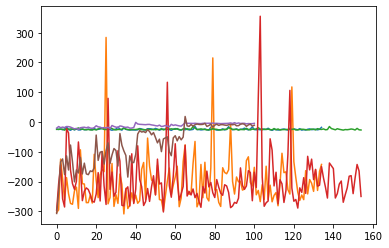

In [62]:
# iwvi.reset_encdec()
# iwvi.load_base()
# iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
# vae_lr=5e-4
# alpha=0.1
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_list_for_mixture_of_gaussian_belief()
plt.plot(train_curve)
plt.plot(valid_curve)


print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

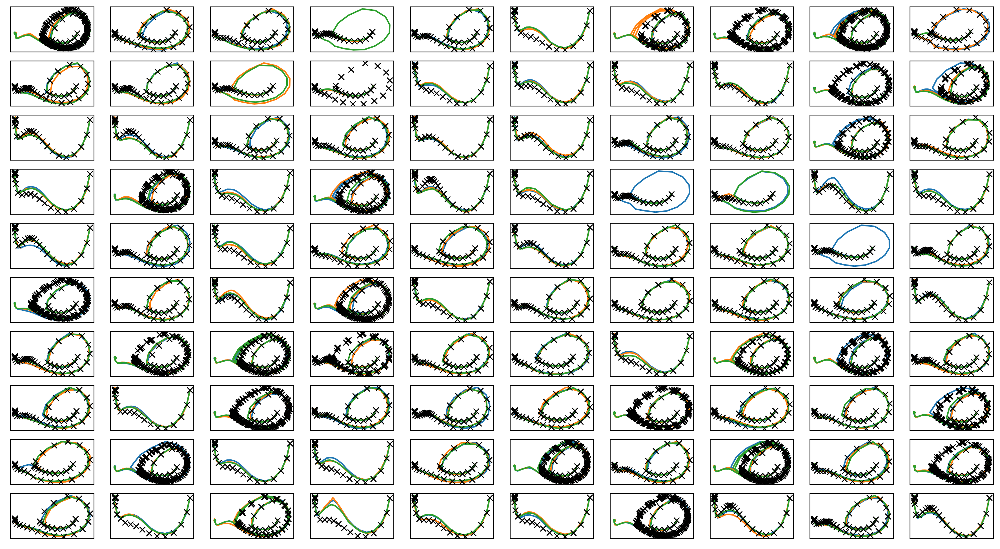

In [63]:
iwvi.get_sim_rollout_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter7.png")
print("実環境方策rollout vs Sim環境方策rollout")

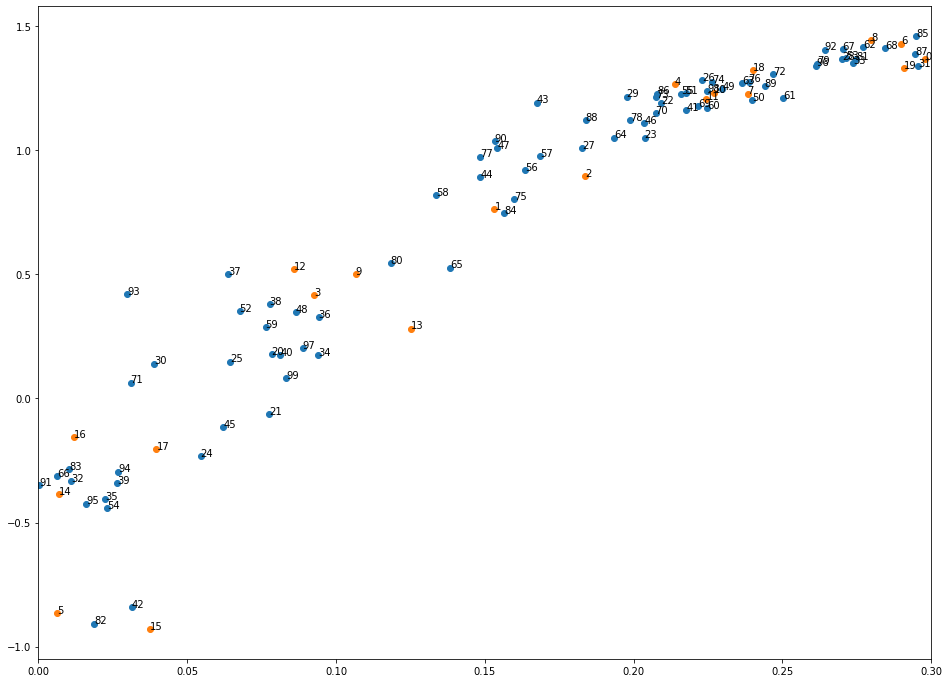

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [64]:
plt.figure(figsize=(16,12))
np_mulogvar = []
for i in range(len(iwvi.mulogvar_list_for_mixture_of_gaussian_belief)):
    np_mulogvar.append(iwvi.mulogvar_list_for_mixture_of_gaussian_belief[i].numpy())
np_mulogvar = np.array(np_mulogvar)

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

# Iter8